<a href="https://www.kaggle.com/code/romikgosai2000/imgcolorizejan23?scriptVersionId=160113743" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
import tensorflow as tf
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import cv2
from tensorflow.keras import layers
from keras.models import Model, Sequential
from keras.layers import Dense, Conv2D, Flatten, BatchNormalization, LeakyReLU
from keras.layers import Conv2DTranspose, Dropout, ReLU, Input, Concatenate, ZeroPadding2D
from keras.optimizers import Adam
from keras.utils import plot_model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow_addons as tfa


/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/opt/conda/lib/python3.10/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [2]:
import tensorflow as tf

physical_devices = tf.config.list_physical_devices('GPU')
if len(physical_devices) == 0:
    print("No GPU devices found. Make sure your GPU is properly installed and configured.")
else:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)
    print("GPU configured successfully.")

GPU configured successfully.


In [3]:
import tensorflow as tf

# Check available GPUs
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    # Restrict TensorFlow to only allocate GPU memory growth
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
        print("GPU memory growth set to True")
    except RuntimeError as e:
        print(e)

GPU memory growth set to True


In [4]:
import tensorflow as tf

# Check if TensorFlow can access GPU
num_gpus = len(tf.config.experimental.list_physical_devices('GPU'))

if num_gpus > 0:
    print("Num GPUs Available: ", num_gpus)
    print("TensorFlow is using GPU.")
else:
    print("No GPU available. TensorFlow is using CPU.")


Num GPUs Available:  1
TensorFlow is using GPU.


In [5]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.cast(image,tf.float32)
    return image

In [6]:
path = "/kaggle/input/monumentimagenotaugmented/"
x = load(os.path.join(path, 'train/Train_3221.jpg'))
print(x.shape)

(300, 300, 3)


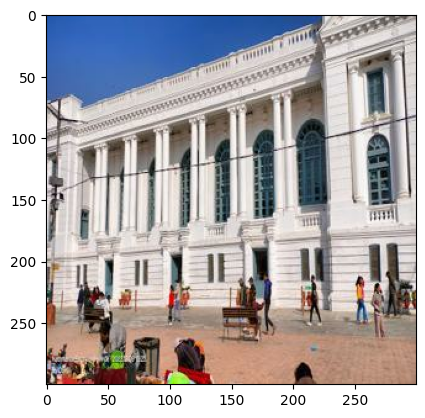

In [7]:
plt.imshow(x/255.0)

In [8]:
def normalize(real_image):
    real_image = (real_image / 255)
    return real_image

In [9]:
def random_crop(real_image):
    cropped_image = tf.image.random_crop(real_image, size = [256, 256, 3])
    return cropped_image

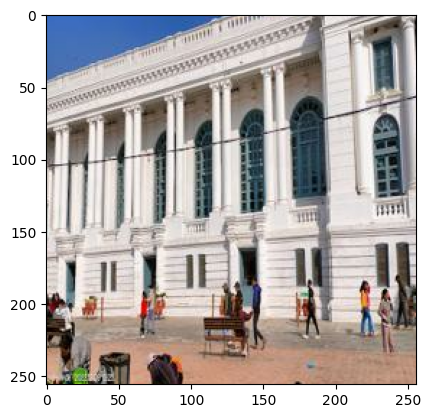

In [10]:
x_aug = random_crop(x)
plt.imshow(x_aug/255.0)

In [11]:
def resize(real_image):
    real_image = tf.image.resize(real_image, [256, 256], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return real_image

In [12]:
def rotate_image(image, angles, interpolation='BILINEAR'):
    """
    Rotate an image tensor by specified angles.

    Args:
    - image: Input image tensor with shape (batch_size, height, width, channels).
    - angles: Tensor of rotation angles in radians for each image in the batch.
    - interpolation: Interpolation method ('BILINEAR' or 'NEAREST').

    Returns:
    - Rotated image tensor.
    """
    batch_size, height, width, channels = tf.unstack(tf.shape(image))

    # Coordinates of the center of the image
    center_x = tf.cast(width, tf.float32) / 2.0
    center_y = tf.cast(height, tf.float32) / 2.0

    # Define transformation matrix
    rotation_matrix = tf.reshape(tf.stack([tf.cos(angles), -tf.sin(angles), center_x * (1 - tf.cos(angles)) + center_y * tf.sin(angles),
                                           tf.sin(angles), tf.cos(angles), -center_x * tf.sin(angles) + center_y * (1 - tf.cos(angles)),
                                           0.0, 0.0, 1.0], axis=1), shape=(-1, 3, 3))

    # Apply rotation to each pixel
    rotated_image = tfa.image.transform(image, rotation_matrix, interpolation)

    return rotated_image


In [13]:
def random_jitter(real_image):
    if tf.random.uniform(()) > 0.5:
        real_image = tf.image.flip_left_right(real_image)
    return real_image

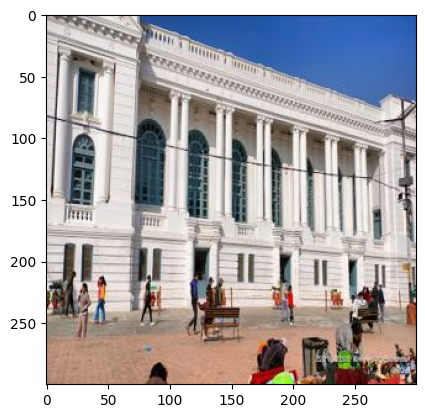

In [14]:
x_jitter = random_jitter(x)
plt.imshow(x_jitter/255.0)

In [15]:
def load_train_images(image_path):
    real_image = load(image_path)
    real_image = tf.image.random_brightness(real_image, 0.2)
    real_image = random_crop(real_image)
    # Define the rotation angle in radians
    rotation_angle = tf.constant(20.0 * (3.141592653589793 / 180.0), dtype=tf.float32)

    # Apply the rotation using tfa.image.rotate
    real_image = tfa.image.rotate(real_image, angles=rotation_angle)

#     # Example usage
#     angles = tf.placeholder(dtype=tf.float32, shape=(None,))
#     # Specify the rotation range in degrees
#     rotation_range = 15  # Adjust this value as needed
#     # Convert the rotation range to radians
#     rotation_range_rad = rotation_range * (np.pi / 180.0)
#     # Generate random rotation angles for each image in the batch
#     random_angles = tf.random.uniform(shape=(tf.shape(image)[0],), minval=-rotation_range_rad, maxval=rotation_range_rad)
#     # Apply custom rotation to the image with bilinear interpolation
#     real_image = rotate_image(real_image, random_angles, interpolation='BILINEAR')
    #     real_image = rotate(real_image)
    real_image = random_jitter(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [16]:
def load_test_image(image_path):
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:]  # AB channels
    #here L_channel becomes input i.e light/luminance of pixel and AB_channels become target
    return Y_channel, UV_channels

In [17]:
IMAGE_SIZE = 256
BATCH_SIZE = 32

In [18]:
# create input pipeline
train_dataset = tf.data.Dataset.list_files(path + "train/*.jpg")
train_dataset = train_dataset.map(load_train_images)
train_dataset = train_dataset.shuffle(10).batch(BATCH_SIZE)
train_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 2), dtype=tf.float32, name=None))>

In [19]:
test_dataset = tf.data.Dataset.list_files(path + 'val/*.jpg')
test_dataset = test_dataset.map(load_test_image)
test_dataset = test_dataset.batch(BATCH_SIZE)
test_dataset

<_BatchDataset element_spec=(TensorSpec(shape=(None, 256, 256, 1), dtype=tf.float32, name=None), TensorSpec(shape=(None, 256, 256, 2), dtype=tf.float32, name=None))>

In [20]:
# downsample block
def downsample(filters, size,dropout=False, batchnorm = True):
    init = tf.random_normal_initializer(0.,0.02)
    result = Sequential()
    result.add(Conv2D(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    if batchnorm == True:
        result.add(BatchNormalization())
    if dropout == True :
        result.add(Dropout(0.3))
    result.add(LeakyReLU())
    return result
down_model = downsample(3,4)
down_result = down_model(tf.expand_dims(x, axis = 0))
print(down_result.shape)

(1, 150, 150, 3)


In [21]:
# upsample block
def upsample(filters, size, dropout = False):
    init = tf.random_normal_initializer(0, 0.02)
    result = Sequential()
    result.add(Conv2DTranspose(filters, size, strides = 2, padding = "same", kernel_initializer = init, use_bias = False))
    result.add(BatchNormalization())
    if dropout == True:
        result.add(Dropout(0.3))
    result.add(ReLU())
    return result
up_model = upsample(3,4)
up_result = up_model(down_result)
print(up_result.shape)

(1, 300, 300, 3)


In [22]:
def generator(input_shape = (256,256,1), output_channels = 2):
    inputs = Input(shape = input_shape)
    down_stack = [
        downsample(64, 4, batchnorm=False),
        downsample(128, 4),
        downsample(256, 4),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True),
        downsample(512, 4, dropout = True)
    ]


    up_stack = [
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(512, 4, dropout=True),
        upsample(256, 4, dropout=True),
        upsample(128, 4),
        upsample(64, 4),
    ]
    init = tf.random_normal_initializer(0., 0.02)
    last = Conv2DTranspose(2, 4, strides = 2, padding = "same", kernel_initializer = init, activation ="tanh")
    x = inputs
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)
    skips = reversed(skips[:-1])

    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = Concatenate()([x, skip])

    x = last(x)
    return Model(inputs = inputs, outputs = x)

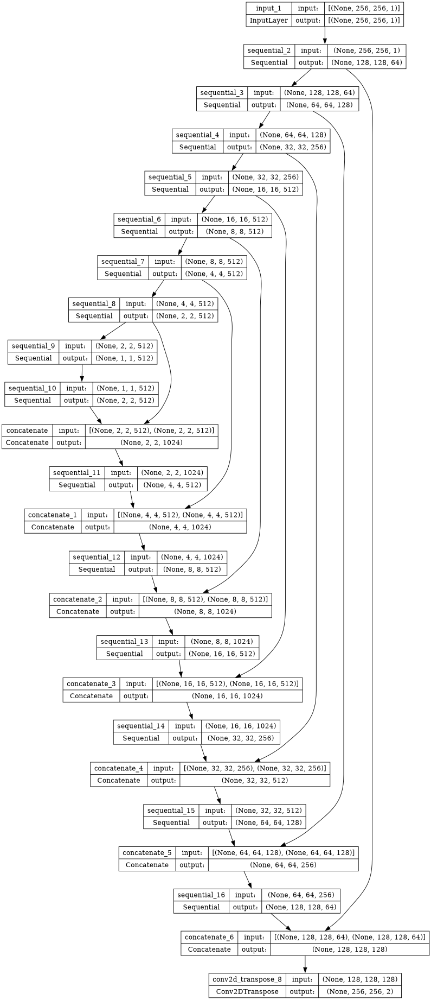

In [23]:
gen = generator()
plot_model(gen, show_shapes=True, dpi = 64)

In [24]:
def discriminator():
    init = tf.random_normal_initializer(0., 0.02)

    inp = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 1], name = "input_image")
    tar = Input(shape = [IMAGE_SIZE, IMAGE_SIZE, 2], name = "target_image")
    x = Concatenate()([inp, tar])
    down1 = downsample(64,4,False)(x)
    down2 = downsample(128, 4)(down1)
    down3 = downsample(256, 4)(down2)

    zero_pad1 = ZeroPadding2D()(down3)
    conv = Conv2D(256, 4, strides = 1, kernel_initializer = init, use_bias = False)(zero_pad1)
    leaky_relu = LeakyReLU()(conv)
    zero_pad2 = ZeroPadding2D()(leaky_relu)
    last = Conv2D(1, 4, strides = 1, kernel_initializer=init)(zero_pad2)
    return Model(inputs = [inp, tar], outputs = last)

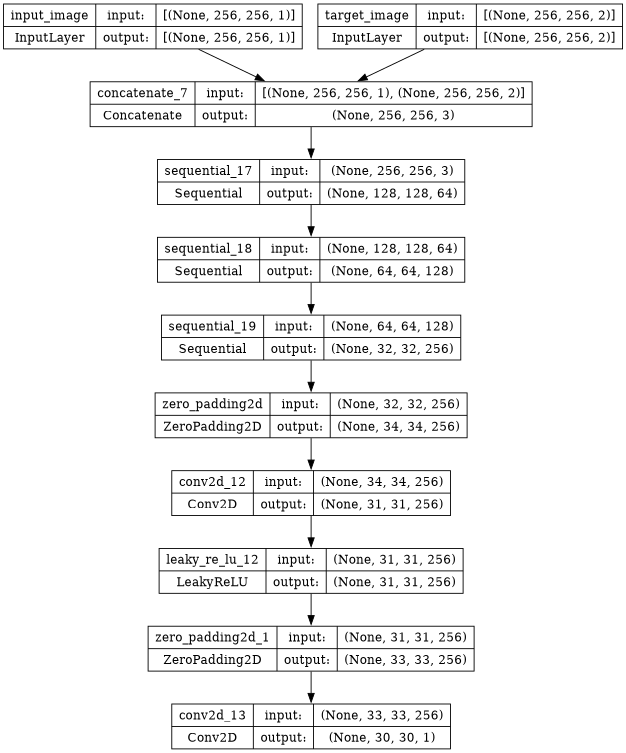

In [25]:
disc = discriminator()
plot_model(disc, show_shapes=True, dpi = 64)

In [26]:
# Function to create YUV image from Y, U, and V channels and then convert to rgb
def create_rgb_image(y_channel, uv_channel):
    # Assuming YUV format where Y, U, and V channels are separate
    # y_channel = np.array(y_channel)
    # uv_channel = np.array(uv_channel)
    u_channel, v_channel = tf.split(uv_channel, num_or_size_splits=2, axis=-1)

    # Combine Y, U, and V channels into a YUV image
    rgb_image = tf.image.yuv_to_rgb(tf.concat([y_channel, u_channel, v_channel], axis=-1))
    return rgb_image


In [27]:
LAMBDA = 50

In [28]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_function(tf.ones_like(disc_generated_output), disc_generated_output)
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA * l1_loss)
    return total_gen_loss, gan_loss, l1_loss

In [29]:
from keras.losses import BinaryCrossentropy
loss_function = BinaryCrossentropy(from_logits=True)

In [30]:
def discriminator_loss(disc_real_output, disc_generated_output):
    real_loss = loss_function(tf.ones_like(disc_real_output), disc_real_output)
    generated_loss = loss_function(tf.zeros_like(disc_generated_output), disc_generated_output)
    total_disc_loss = real_loss + generated_loss
    return total_disc_loss, real_loss, generated_loss

In [31]:
generator_optimizer = Adam(lr= 2e-4, beta_1=0.5)
discriminator_optimizer = Adam(lr = 2e-4, beta_1=0.5)

In [32]:
epochs = 200

In [33]:
@tf.function
def train_step(input_image, target, epoch, training_discriminator):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        gen_output = gen(input_image, training=True)
        disc_real_output = disc([input_image, target], training=True)
        disc_generated_output = disc([input_image, gen_output], training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
        disc_loss, disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)

        ssim_values = tf.image.ssim(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
        psnr_values = tf.image.psnr(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
        if epoch > 10:
            if training_discriminator:
                discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
                discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))
            else:
                generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
                generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
        else:
            generator_gradients = gen_tape.gradient(gen_total_loss, gen.trainable_variables)
            discriminator_gradients = disc_tape.gradient(disc_loss, disc.trainable_variables)
            generator_optimizer.apply_gradients(zip(generator_gradients, gen.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(discriminator_gradients, disc.trainable_variables))

        return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values

In [34]:
@tf.function
def test_step(input_image, target):
    # Generate output using the generator
    gen_output = gen(input_image)

    # Calculate losses without updating gradients
    disc_real_output = disc([input_image, target])
    disc_generated_output = disc([input_image, gen_output])

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss,disc_real_loss, disc_generated_loss = discriminator_loss(disc_real_output, disc_generated_output)

    ssim_values = tf.image.ssim(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
    psnr_values = tf.image.psnr(create_rgb_image(input_image, target), create_rgb_image(input_image,gen_output), max_val=1.0)
    #accuracy = calculate_accuracy(disc_generated_output, disc_real_output)
    return gen_total_loss, gen_gan_loss, gen_l1_loss, disc_loss,disc_real_loss, disc_generated_loss, ssim_values, psnr_values


In [35]:
os.mkdir('/kaggle/working/gen_output/')

In [36]:
def display_one_random_test_image(input_, target, gen_model, epoch):
    print("Displaying one random test image...")
    img_array = np.array(input_)
    generated_output_test = gen_model(input_)
    ssim = tf.image.ssim(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)
    psnr = tf.image.psnr(tf.reshape(create_rgb_image(input_, target), (256,256,3)), tf.reshape(create_rgb_image(input_,generated_output_test), (256,256,3)), max_val=1.0)  
    # print(input_.shape)
    input_ = np.squeeze(input_, axis=0)
    # print(type(input_), type(target))
    # print(input_.shape, input_)
    # input_.reshape((256,256))
    plt.figure(figsize=(16, 16))
    plt.subplot(1, 4, 1)
    plt.title('Input Testing Image')
    plt.imshow(input_, cmap='gray', vmax = 1, vmin = 0)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # print(target.shape)
    target = np.squeeze(target, axis=0)
    # # print(target.shape)
    target_img = create_rgb_image(input_, target).numpy()
    # # print(type(target_img))
    # target
    # # print(target_img.shape, target_img)
    plt.subplot(1, 4, 2)
    plt.title('Target Testing Image')
    plt.imshow(target_img)  # Assuming images are normalized to [0, 1]
    plt.axis('off')
    # # Convert PIL Image to NumPy array
    # img_array = np.array(input_)
    # # Add batch dimension
    # # print(img_array.shape)
    # img_array = np.expand_dims(img_array, axis=0)
    # # print(img_array.shape)
    # generated_output_test = gen_model(img_array)
    # # print(generated_output_test.shape)
    # # Squeeze the singleton dimension
    generated_output_test = np.squeeze(generated_output_test, axis=0)
    # # print(generated_output_test.shape)
    generated_img = create_rgb_image(input_, generated_output_test).numpy()
    # # print(generated_img.shape, generated_img)
    plt.subplot(1, 4, 3)
    plt.title(f'Generated Output -- epoch {epoch}')
    plt.imshow(generated_img)  # Assuming images are normalized to [-1, 1]
    plt.axis('off')
    plt.savefig(f'/kaggle/working/gen_output/epoch_{epoch}.png')
    plt.show()
    print('SSIM Score: {}'.format(ssim))
    print('PSNR Score: {}'.format(psnr))

In [37]:
def display_random_test_image(gen_model, image_path, epoch):
    
    real_image = load(image_path)
    real_image = resize(real_image)
    real_image = normalize(real_image)
    yuv_image = tf.image.rgb_to_yuv(real_image)
    # Separate LAB into L and AB components
    Y_channel = tf.expand_dims(yuv_image[:, :, 0], axis=-1)  # L channel
    UV_channels = yuv_image[:, :, 1:] 

    # Display the image
    display_one_random_test_image(tf.reshape(Y_channel, (1,256,256,1)),tf.reshape(UV_channels,(1,256,256,2)), gen_model, epoch)


Displaying one random test image...


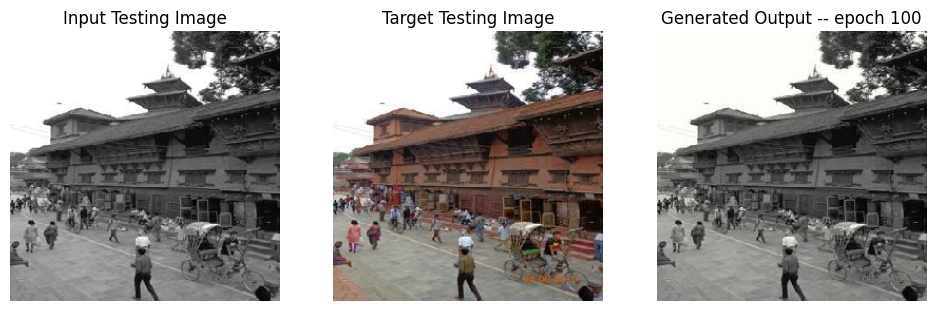

SSIM Score: 0.9176535606384277
PSNR Score: 27.554746627807617


In [38]:
display_random_test_image(gen, '/kaggle/input/monumentimagenotaugmented/val/Val_1000.jpg',100)

In [39]:
import random

each_epoch_train_generator_losses = []
each_epoch_train_generator_gan_losses = []
each_epoch_train_generator_l1_losses = []
each_epoch_train_discriminator_losses = []
each_epoch_train_discriminator_real_losses = []
each_epoch_train_discriminator_generated_losses = []
each_epoch_train_ssim = []
each_epoch_train_psnr = []
each_epoch_test_psnr = []
each_epoch_test_ssim = []
each_epoch_test_generator_losses = []
each_epoch_test_generator_gan_losses = []
each_epoch_test_generator_l1_losses = []
each_epoch_test_discriminator_losses = []
each_epoch_test_discriminator_real_losses = []
each_epoch_test_discriminator_generated_losses = []
train_generator_losses = []
train_generator_gan_losses = []
train_generator_l1_losses = []
train_discriminator_losses = []
train_discriminator_real_losses = []
train_discriminator_generated_losses = []
test_generator_losses = []
test_generator_gan_losses = []
test_generator_l1_losses = []
test_discriminator_losses = []
test_discriminator_real_losses = []
test_discriminator_generated_losses =[]
training_ssim = []
training_psnr = []
testing_ssim = []
testing_psnr = []
each_epoch_all_records = []
all_records = []
def fit(train_ds, epochs, test_ds, gen_model):

    # Declare global lists
    global each_epoch_train_generator_losses, each_epoch_train_generator_gan_losses, each_epoch_train_generator_l1_losses, each_epoch_train_discriminator_losses,each_epoch_train_discriminator_real_losses, each_epoch_train_discriminator_generated_losses, each_epoch_train_ssim, each_epoch_train_psnr
    global each_epoch_test_psnr, each_epoch_test_ssim, each_epoch_test_generator_losses, each_epoch_test_generator_gan_losses, each_epoch_test_generator_l1_losses, each_epoch_test_discriminator_losses, each_epoch_test_discriminator_real_losses, each_epoch_test_discriminator_generated_losses
    global train_generator_losses, train_generator_gan_losses, train_generator_l1_losses, train_discriminator_losses, train_discriminator_real_losses, train_discriminator_generated_losses, test_generator_losses, test_generator_gan_losses, test_generator_l1_losses, test_discriminator_losses, test_discriminator_real_losses, test_discriminator_generated_losses
    global training_ssim, training_psnr, testing_ssim, testing_psnr, each_epoch_all_records, all_records, LAMBDA


    # Initialize counters and flags
    consecutive_epochs_high_loss = 0
    training_discriminator = True
    stop_training = False
    min_learning_rate = 1e-7  # Set your desired minimum learning rate

    for epoch in range(epochs):
        start = time.time()
        train_count = 0
        test_count = 0

        print(f"Epoch {epoch}")

        for n, (input_, target) in train_ds.enumerate():
            if epoch > 10:
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr = train_step(input_, target, epoch, training_discriminator=training_discriminator)

            else:
                # If epoch is less than or equal to 10, train both generator and discriminator
                train_gen_loss, train_gen_gan_loss, train_gen_l1_loss, train_disc_loss, train_disc_real_loss, train_disc_generated_loss, train_ssim, train_psnr  = train_step(input_, target, epoch, training_discriminator=None)

            each_epoch_train_generator_losses.append(train_gen_loss)
            each_epoch_train_generator_gan_losses.append(train_gen_gan_loss)
            each_epoch_train_generator_l1_losses.append(train_gen_l1_loss)
            each_epoch_train_discriminator_losses.append(train_disc_loss)
            each_epoch_train_discriminator_real_losses.append(train_disc_real_loss)
            each_epoch_train_discriminator_generated_losses.append(train_disc_generated_loss)
            each_epoch_train_ssim.append(tf.reduce_mean(train_ssim.numpy()))
            each_epoch_train_psnr.append(tf.reduce_mean(train_psnr.numpy()))
            train_count += 1
        #each_epoch_train_generator_losses = np.array(each_epoch_train_generator_losses)
        #print(each_epoch_train_discriminator_losses.shape())
        #print(each_epoch_train_generator_losses.shape())
        #print(each_epoch_train_ssim())
        print("Training Details")
        print("Generator-- total_loss:{:.2f} gan_loss:{:.2f} l1_loss:{:.2f} Discriminator-- total_loss:{:.2f} real_loss:{:.2f} generated_loss:{:.2f} --- SSIM {:.2f} PSNR {:.2f}".format(np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr)))
        print("Time taken for epoch {} is {} sec".format(epoch + 1, time.time() - start))
        print("Number of iteration {d}", train_count)

        train_generator_losses.append(np.mean(each_epoch_train_generator_losses))
        train_generator_gan_losses.append(np.mean(each_epoch_train_generator_gan_losses))
        train_generator_l1_losses.append(np.mean(each_epoch_train_generator_l1_losses))
        train_discriminator_losses.append(np.mean(each_epoch_train_discriminator_losses))
        train_discriminator_real_losses.append(np.mean(each_epoch_train_discriminator_real_losses))
        train_discriminator_generated_losses.append(np.mean(each_epoch_train_discriminator_generated_losses))
        training_ssim.append(np.mean(each_epoch_train_ssim))
        training_psnr.append(np.mean(each_epoch_train_psnr))

        # Test
        for n, (input_, target) in test_ds.enumerate():
            test_gen_loss, test_gen_gan_loss, test_gen_l1_loss, test_disc_loss, test_disc_real_loss, test_disc_generated_loss, test_ssim, test_psnr = test_step(input_, target)
            test_count += 1

            each_epoch_test_generator_losses.append(test_gen_loss)
            each_epoch_test_generator_gan_losses.append(test_gen_gan_loss)
            each_epoch_test_generator_l1_losses.append(test_gen_l1_loss)
            each_epoch_test_discriminator_losses.append(test_disc_loss)
            each_epoch_test_discriminator_real_losses.append(test_disc_real_loss)
            each_epoch_test_discriminator_generated_losses.append(test_disc_generated_loss)
            each_epoch_test_ssim.append(tf.reduce_mean(test_ssim.numpy()))
            each_epoch_test_psnr.append(tf.reduce_mean(test_psnr.numpy()))
        print("Testing Details")
        print("Generator-- total_loss:{:.2f} gan_loss:{:.2f} l1_loss:{:.2f} Discriminator-- total_loss:{:.2f} real_loss:{:.2f} generated_loss:{:.2f} --- SSIM {:.2f} PSNR {:.2f}".format(np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr)))
        print("Time taken for epoch {} is {} sec".format(epoch+1, time.time() - start))
        print(f"Number of iteration {test_count}: and Lambda = {LAMBDA}")

        test_generator_losses.append(np.mean(each_epoch_test_generator_losses))
        test_generator_gan_losses.append(np.mean(each_epoch_test_generator_gan_losses))
        test_generator_l1_losses.append(np.mean(each_epoch_test_generator_l1_losses))
        test_discriminator_losses.append(np.mean(each_epoch_test_discriminator_losses))
        test_discriminator_real_losses.append(np.mean(each_epoch_test_discriminator_real_losses))
        test_discriminator_generated_losses.append(np.mean(each_epoch_test_discriminator_generated_losses))
        testing_ssim.append(np.mean(each_epoch_test_ssim))
        testing_psnr.append(np.mean(each_epoch_test_psnr))
        each_epoch_all_records.append([np.mean(each_epoch_train_generator_losses),np.mean(each_epoch_train_generator_gan_losses), np.mean(each_epoch_train_generator_l1_losses), np.mean(each_epoch_train_discriminator_losses), np.mean(each_epoch_train_discriminator_generated_losses), np.mean(each_epoch_train_discriminator_real_losses), np.mean(each_epoch_train_ssim), np.mean(each_epoch_train_psnr), np.mean(each_epoch_test_generator_losses),np.mean(each_epoch_test_generator_gan_losses), np.mean(each_epoch_test_generator_l1_losses), np.mean(each_epoch_test_discriminator_losses), np.mean(each_epoch_test_discriminator_generated_losses), np.mean(each_epoch_test_discriminator_real_losses), np.mean(each_epoch_test_ssim), np.mean(each_epoch_test_psnr),LAMBDA])
        all_records.append(each_epoch_all_records)
        # emptying for next epoch
        each_epoch_test_ssim = []
        each_epoch_test_generator_losses = []
        each_epoch_test_generator_gan_losses = []
        each_epoch_test_generator_l1_losses = []
        each_epoch_test_discriminator_losses = []
        each_epoch_test_discriminator_real_losses = []
        each_epoch_test_discriminator_generated_losses = []
        each_epoch_test_psnr = []
        each_epoch_all_records = []
        #emptyling list for next iteration
        each_epoch_train_generator_losses = []
        each_epoch_train_generator_gan_losses = []
        each_epoch_train_generator_l1_losses = []
        each_epoch_train_discriminator_losses = []
        each_epoch_train_discriminator_real_losses = []
        each_epoch_train_discriminator_generated_losses = []
        each_epoch_train_ssim = []
        each_epoch_train_psnr = []
        if epoch == 0 or epoch % 5 == 0:
            # Function to display one random test image
            # def display_random_test_image(images, labels, gen_model):
            #     # Randomly select an index
            #     random_test_image_idx = random.randint(0, len(images) - 1)

            #     # Extract input and target from the selected index
            #     random_test_input = images[random_test_image_idx]
            #     random_test_target = labels[random_test_image_idx]

            #     # Display the image
            #     display_one_random_test_image(random_test_input, random_test_target, gen_model)

            # Example usage
            display_random_test_image(gen, '/kaggle/input/monumentimagenotaugmented/val/Val_1000.jpg', epoch+1)
        # Check if the difference between two consecutive epochs for the last 5 epochs is less than 1
        if epoch > 10:
            # Check 1f the difference between two consecutive epochs for the last S epochs is less than 1 or 0.3
            last_epochs_losses = train_discriminator_losses[-5:] if training_discriminator else train_generator_losses[-5:]
            if all(((last_epochs_losses[i] - last_epochs_losses[i - 1])) < 0.01 if training_discriminator else ((last_epochs_losses[1] - last_epochs_losses[i - 1])) < 0.05 for i in range(1, 5)):
                consecutive_epochs_high_loss += 1
            else:
                consecutive_epochs_high_loss = 0
            # If the condition is met for 3 consecutive epochs, reduce the learning rate
        if consecutive_epochs_high_loss == 3:
            LAMBDA = LAMBDA * 1.08
            if training_discriminator:
                current_lr = generator_optimizer. learning_rate.numpy()
                new_lr = max (current_lr * 0.8, min_learning_rate)
                if new_lr > min_learning_rate:
                    generator_optimizer.learning_rate.assign(new_lr)
                    print (f"Reduced generator learning rate to {new_lr} at epoch {epoch + 1}")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Generator learning rate already at the minimum. Stopping training.")
                    stop_training = True
            else:
                current_lr = discriminator_optimizer.learning_rate.numpy()
                new_lr = max (current_lr * 0.8, min_learning_rate)
                if new_lr > min_learning_rate:
                    discriminator_optimizer.learning_rate.assign(new_lr)
                    print(f"Reduced discriminator learning rate to {new_lr} at epoch {epoch + 1}.")
                    # Switch training focus
                    training_discriminator = not training_discriminator
                else:
                    print(f"Discriminator learning rate already at the minimum. Stopping training.")
                    stop_training = True

                consecutive_epochs_high_loss = 0
        # Check the flag variable
        if stop_training:
            break

In [40]:
tf.config.run_functions_eagerly(True)

Epoch 0
Training Details
Generator-- total_loss:3.19 gan_loss:0.88 l1_loss:0.05 Discriminator-- total_loss:1.44 real_loss:0.77 generated_loss:0.67 --- SSIM 0.88 PSNR 22.53
Time taken for epoch 1 is 182.0951931476593 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.62 gan_loss:0.35 l1_loss:0.15 Discriminator-- total_loss:1.61 real_loss:1.25 generated_loss:0.36 --- SSIM 0.75 PSNR 13.92
Time taken for epoch 1 is 197.30786728858948 sec
Number of iteration 70: and Lambda = 50
Displaying one random test image...


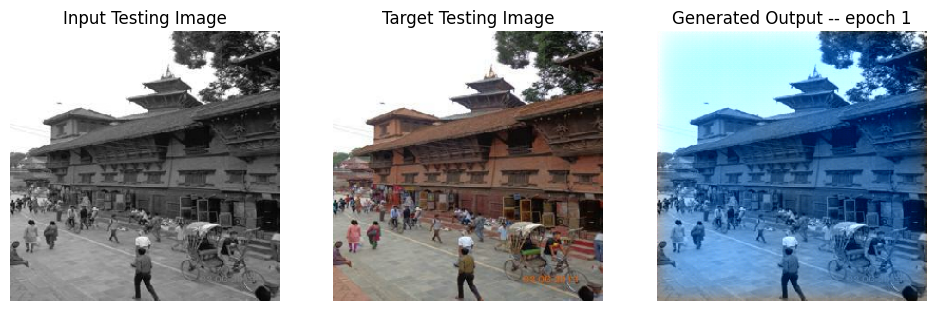

SSIM Score: 0.7636449933052063
PSNR Score: 13.727063179016113
Epoch 1
Training Details
Generator-- total_loss:2.76 gan_loss:0.81 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.68 generated_loss:0.68 --- SSIM 0.93 PSNR 23.61
Time taken for epoch 2 is 176.2187294960022 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.33 gan_loss:0.44 l1_loss:0.08 Discriminator-- total_loss:1.55 real_loss:1.12 generated_loss:0.42 --- SSIM 0.89 PSNR 19.05
Time taken for epoch 2 is 190.44162702560425 sec
Number of iteration 70: and Lambda = 50
Epoch 2
Training Details
Generator-- total_loss:2.77 gan_loss:0.81 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.68 generated_loss:0.68 --- SSIM 0.93 PSNR 23.44
Time taken for epoch 3 is 176.21148443222046 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.20 gan_loss:1.01 l1_loss:0.04 Discriminator-- total_loss:1.48 real_loss:0.58 generated_loss:0.90 --- SSIM 0.93 PSNR 23.06
Time taken for epoch 3 is 

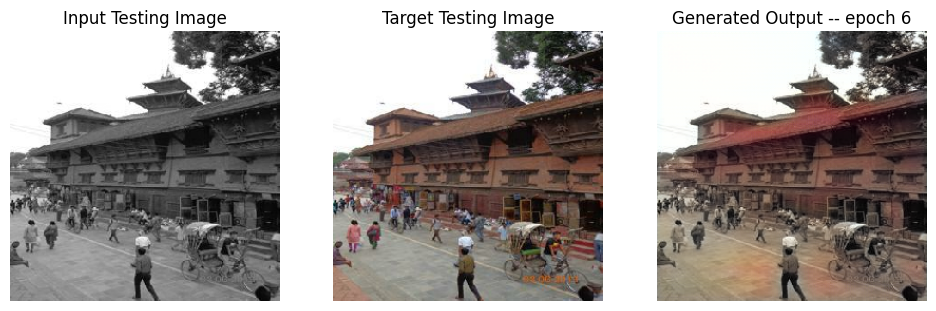

SSIM Score: 0.9712221622467041
PSNR Score: 27.886133193969727
Epoch 6
Training Details
Generator-- total_loss:2.69 gan_loss:0.78 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.68 generated_loss:0.68 --- SSIM 0.94 PSNR 23.66
Time taken for epoch 7 is 176.65063285827637 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.91 gan_loss:0.63 l1_loss:0.05 Discriminator-- total_loss:1.37 real_loss:0.79 generated_loss:0.58 --- SSIM 0.94 PSNR 22.67
Time taken for epoch 7 is 190.8627905845642 sec
Number of iteration 70: and Lambda = 50
Epoch 7
Training Details
Generator-- total_loss:2.69 gan_loss:0.77 l1_loss:0.04 Discriminator-- total_loss:1.36 real_loss:0.67 generated_loss:0.68 --- SSIM 0.94 PSNR 23.70
Time taken for epoch 8 is 175.48736834526062 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.96 gan_loss:0.64 l1_loss:0.07 Discriminator-- total_loss:1.82 real_loss:0.86 generated_loss:0.96 --- SSIM 0.91 PSNR 20.04
Time taken for epoch 8 is 

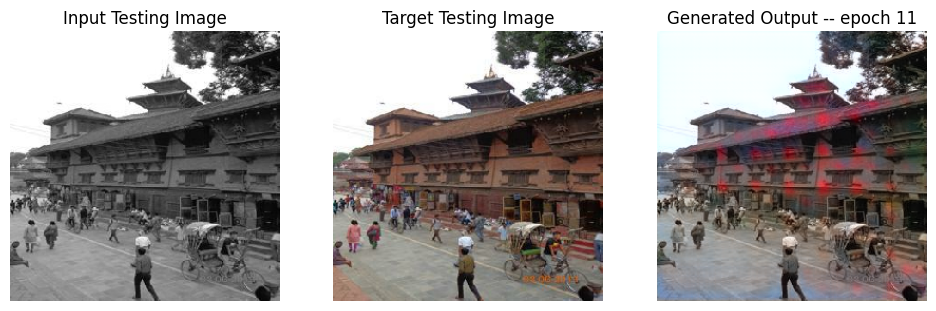

SSIM Score: 0.9515237808227539
PSNR Score: 26.35005760192871
Epoch 11
Training Details
Generator-- total_loss:3.47 gan_loss:1.45 l1_loss:0.04 Discriminator-- total_loss:2.48 real_loss:1.27 generated_loss:1.20 --- SSIM 0.93 PSNR 23.04
Time taken for epoch 12 is 121.12218236923218 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.20 gan_loss:0.91 l1_loss:0.05 Discriminator-- total_loss:1.39 real_loss:0.56 generated_loss:0.84 --- SSIM 0.93 PSNR 22.50
Time taken for epoch 12 is 135.58757328987122 sec
Number of iteration 70: and Lambda = 50
Epoch 12
Training Details
Generator-- total_loss:3.49 gan_loss:1.48 l1_loss:0.04 Discriminator-- total_loss:1.06 real_loss:0.51 generated_loss:0.54 --- SSIM 0.93 PSNR 23.06
Time taken for epoch 13 is 121.18843269348145 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.77 gan_loss:1.51 l1_loss:0.05 Discriminator-- total_loss:1.77 real_loss:0.39 generated_loss:1.38 --- SSIM 0.93 PSNR 22.58
Time taken for epoch 

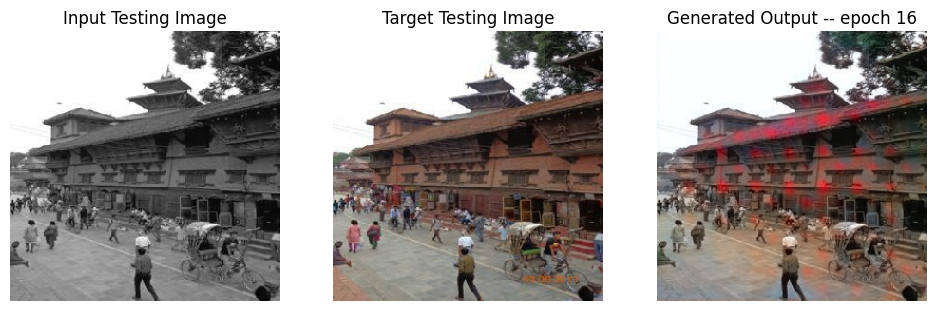

SSIM Score: 0.9486216902732849
PSNR Score: 26.328689575195312
Epoch 16
Training Details
Generator-- total_loss:6.01 gan_loss:4.00 l1_loss:0.04 Discriminator-- total_loss:0.37 real_loss:0.18 generated_loss:0.19 --- SSIM 0.93 PSNR 23.07
Time taken for epoch 17 is 120.42366433143616 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.63 gan_loss:1.37 l1_loss:0.05 Discriminator-- total_loss:1.76 real_loss:0.59 generated_loss:1.17 --- SSIM 0.93 PSNR 22.59
Time taken for epoch 17 is 134.94648337364197 sec
Number of iteration 70: and Lambda = 50
Epoch 17
Training Details
Generator-- total_loss:6.57 gan_loss:4.56 l1_loss:0.04 Discriminator-- total_loss:0.30 real_loss:0.14 generated_loss:0.16 --- SSIM 0.93 PSNR 23.07
Time taken for epoch 18 is 119.89179515838623 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.93 gan_loss:0.67 l1_loss:0.05 Discriminator-- total_loss:1.85 real_loss:1.32 generated_loss:0.54 --- SSIM 0.93 PSNR 22.59
Time taken for epoch

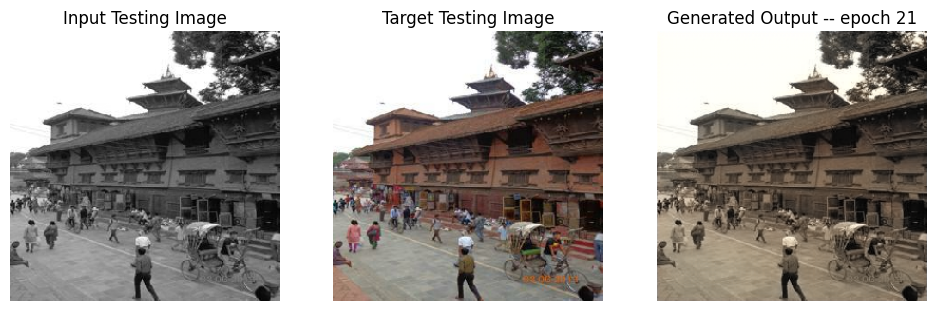

SSIM Score: 0.9788587093353271
PSNR Score: 29.37822723388672
Epoch 21
Training Details
Generator-- total_loss:1.69 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:11.08 real_loss:10.95 generated_loss:0.12 --- SSIM 0.96 PSNR 25.69
Time taken for epoch 22 is 111.91119289398193 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:1.95 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.12 real_loss:10.12 generated_loss:0.00 --- SSIM 0.95 PSNR 25.01
Time taken for epoch 22 is 126.45558309555054 sec
Number of iteration 70: and Lambda = 54.0
Epoch 22
Training Details
Generator-- total_loss:1.68 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:10.66 real_loss:10.55 generated_loss:0.12 --- SSIM 0.96 PSNR 25.75
Time taken for epoch 23 is 111.79872822761536 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.26 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:8.13 real_loss:8.12 generated_loss:0.01 --- SSIM 0.95 PSNR 23.85
Time taken fo

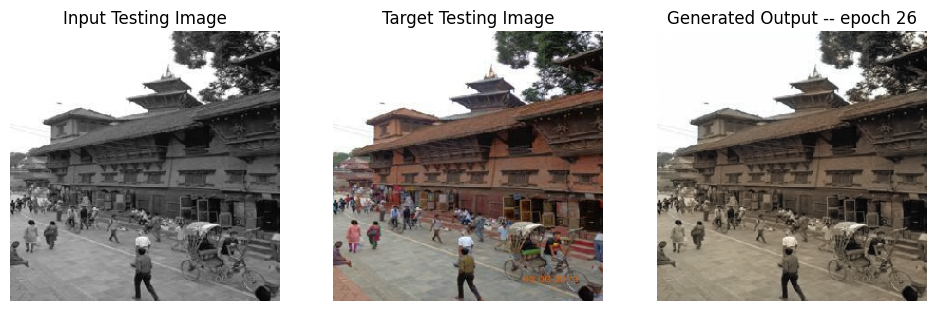

SSIM Score: 0.9797163605690002
PSNR Score: 30.191099166870117
Epoch 26
Training Details
Generator-- total_loss:9.53 gan_loss:7.74 l1_loss:0.03 Discriminator-- total_loss:0.03 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 25.91
Time taken for epoch 27 is 120.17358326911926 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.81 gan_loss:0.74 l1_loss:0.04 Discriminator-- total_loss:2.20 real_loss:1.78 generated_loss:0.42 --- SSIM 0.96 PSNR 25.14
Time taken for epoch 27 is 134.45908999443054 sec
Number of iteration 70: and Lambda = 58.32000000000001
Epoch 27
Training Details
Generator-- total_loss:11.70 gan_loss:9.91 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.90
Time taken for epoch 28 is 121.32029414176941 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.23 gan_loss:1.16 l1_loss:0.04 Discriminator-- total_loss:2.08 real_loss:1.47 generated_loss:0.61 --- SSIM 0.96 PSNR 25.14
Time

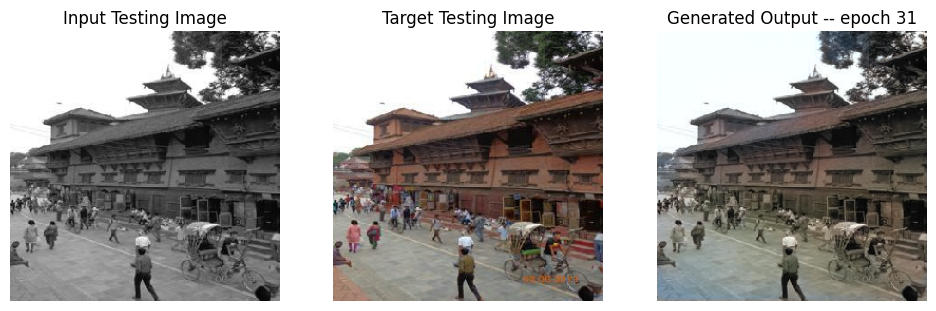

SSIM Score: 0.9746310114860535
PSNR Score: 28.67973518371582
Epoch 31
Training Details
Generator-- total_loss:1.99 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:14.73 real_loss:14.73 generated_loss:0.00 --- SSIM 0.96 PSNR 25.36
Time taken for epoch 32 is 111.4175956249237 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.19 gan_loss:0.00 l1_loss:0.05 Discriminator-- total_loss:14.45 real_loss:14.45 generated_loss:0.00 --- SSIM 0.94 PSNR 21.71
Time taken for epoch 32 is 125.64496231079102 sec
Number of iteration 70: and Lambda = 62.98560000000001
Epoch 32
Training Details
Generator-- total_loss:1.96 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:15.81 real_loss:15.81 generated_loss:0.00 --- SSIM 0.96 PSNR 25.71
Time taken for epoch 33 is 110.74187064170837 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.37 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.00 real_loss:14.00 generated_loss:0.00 --- SSIM 0.95 PSNR 24.72

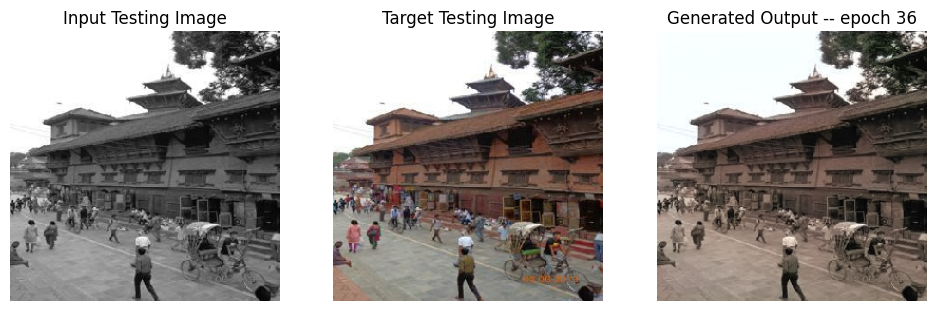

SSIM Score: 0.9790628552436829
PSNR Score: 30.197498321533203
Epoch 36
Training Details
Generator-- total_loss:1.93 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:15.41 real_loss:15.40 generated_loss:0.00 --- SSIM 0.96 PSNR 25.88
Time taken for epoch 37 is 111.19408226013184 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.56 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.38 real_loss:14.38 generated_loss:0.00 --- SSIM 0.95 PSNR 24.05
Time taken for epoch 37 is 125.80366563796997 sec
Number of iteration 70: and Lambda = 62.98560000000001
Reduced discriminator learning rate to 0.0006400000303983689 at epoch 37.
Epoch 37
Training Details
Generator-- total_loss:8.31 gan_loss:6.24 l1_loss:0.03 Discriminator-- total_loss:0.19 real_loss:0.12 generated_loss:0.08 --- SSIM 0.96 PSNR 25.92
Time taken for epoch 38 is 120.83310103416443 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.53 gan_loss:0.09 l1_loss:0.04 Discriminator-- tot

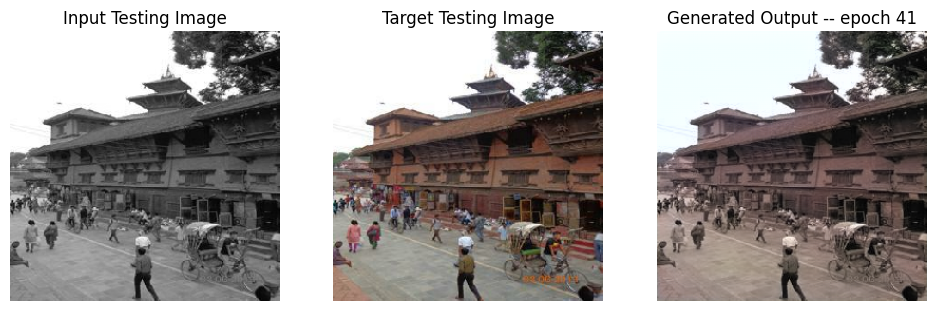

SSIM Score: 0.9771084785461426
PSNR Score: 29.057252883911133
Epoch 41
Training Details
Generator-- total_loss:2.30 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:7.49 real_loss:7.49 generated_loss:0.00 --- SSIM 0.96 PSNR 25.45
Time taken for epoch 42 is 111.0464780330658 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.16 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.08 real_loss:10.08 generated_loss:0.00 --- SSIM 0.95 PSNR 23.11
Time taken for epoch 42 is 125.22131443023682 sec
Number of iteration 70: and Lambda = 73.46640384000003
Epoch 42
Training Details
Generator-- total_loss:2.27 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:7.58 real_loss:7.58 generated_loss:0.00 --- SSIM 0.96 PSNR 25.60
Time taken for epoch 43 is 110.90107679367065 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.68 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.34 real_loss:10.34 generated_loss:0.00 --- SSIM 0.95 PSNR 24.83
Ti

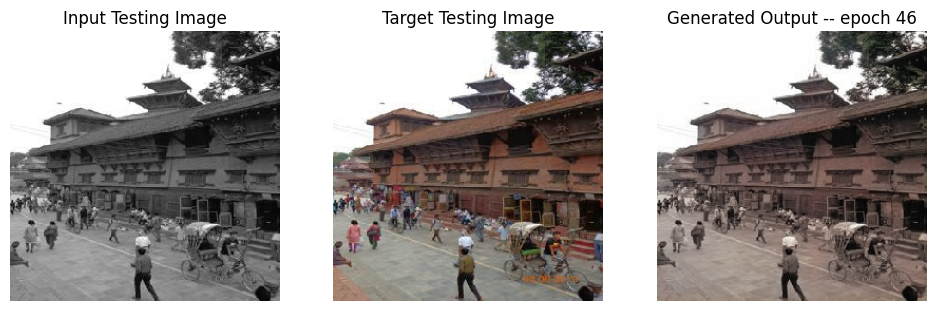

SSIM Score: 0.9795923233032227
PSNR Score: 30.97749900817871
Epoch 46
Training Details
Generator-- total_loss:2.22 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:7.85 real_loss:7.85 generated_loss:0.00 --- SSIM 0.96 PSNR 25.87
Time taken for epoch 47 is 110.54866647720337 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.66 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.56 real_loss:10.56 generated_loss:0.00 --- SSIM 0.95 PSNR 24.87
Time taken for epoch 47 is 124.88672232627869 sec
Number of iteration 70: and Lambda = 73.46640384000003
Epoch 47
Training Details
Generator-- total_loss:2.22 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:7.95 real_loss:7.95 generated_loss:0.00 --- SSIM 0.96 PSNR 25.85
Time taken for epoch 48 is 110.60507345199585 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.65 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.32 real_loss:11.32 generated_loss:0.00 --- SSIM 0.95 PSNR 24.82
Ti

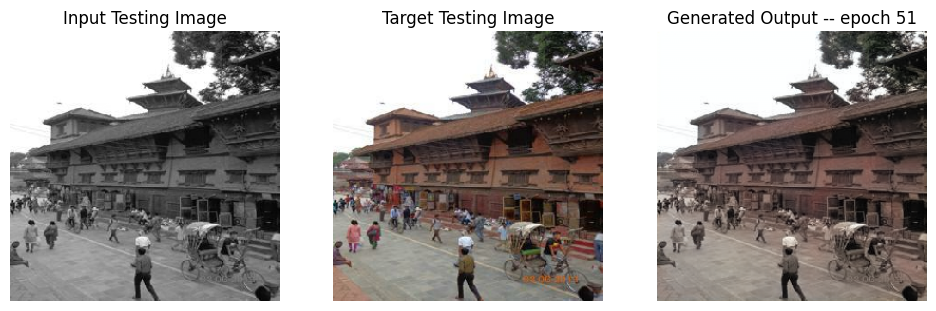

SSIM Score: 0.9798221588134766
PSNR Score: 31.32478141784668
Epoch 51
Training Details
Generator-- total_loss:12.81 gan_loss:10.44 l1_loss:0.03 Discriminator-- total_loss:0.05 real_loss:0.03 generated_loss:0.02 --- SSIM 0.96 PSNR 25.91
Time taken for epoch 52 is 119.84352135658264 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.15 gan_loss:1.33 l1_loss:0.04 Discriminator-- total_loss:1.64 real_loss:0.56 generated_loss:1.08 --- SSIM 0.95 PSNR 25.03
Time taken for epoch 52 is 134.1770384311676 sec
Number of iteration 70: and Lambda = 79.34371614720003
Epoch 52
Training Details
Generator-- total_loss:11.75 gan_loss:9.38 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.91
Time taken for epoch 53 is 120.67745923995972 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.29 gan_loss:1.46 l1_loss:0.04 Discriminator-- total_loss:1.80 real_loss:0.47 generated_loss:1.34 --- SSIM 0.95 PSNR 25.02
Time

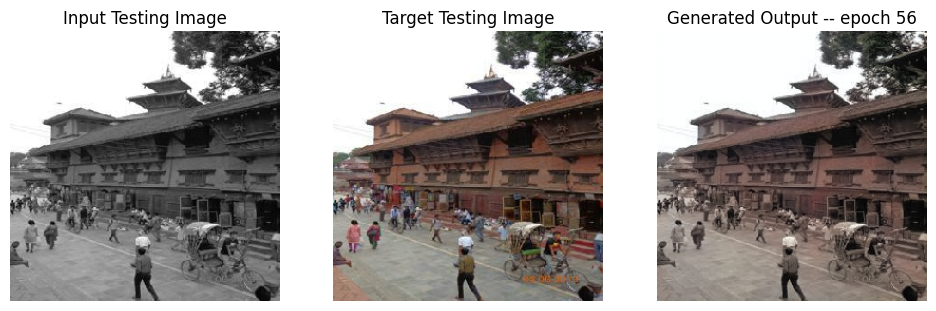

SSIM Score: 0.9797964096069336
PSNR Score: 31.313631057739258
Epoch 56
Training Details
Generator-- total_loss:11.84 gan_loss:9.47 l1_loss:0.03 Discriminator-- total_loss:0.06 real_loss:0.03 generated_loss:0.03 --- SSIM 0.96 PSNR 25.93
Time taken for epoch 57 is 120.14674592018127 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.11 gan_loss:2.29 l1_loss:0.04 Discriminator-- total_loss:2.43 real_loss:0.31 generated_loss:2.13 --- SSIM 0.95 PSNR 25.03
Time taken for epoch 57 is 134.35984706878662 sec
Number of iteration 70: and Lambda = 79.34371614720003
Epoch 57
Training Details
Generator-- total_loss:13.71 gan_loss:11.34 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.93
Time taken for epoch 58 is 120.28537678718567 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.64 gan_loss:1.83 l1_loss:0.04 Discriminator-- total_loss:1.91 real_loss:0.36 generated_loss:1.54 --- SSIM 0.95 PSNR 25.04
Ti

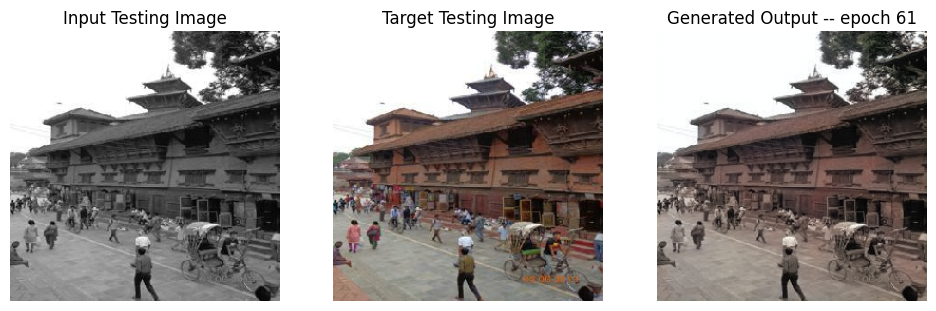

SSIM Score: 0.9798124432563782
PSNR Score: 31.309486389160156
Epoch 61
Training Details
Generator-- total_loss:15.88 gan_loss:13.51 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.90
Time taken for epoch 62 is 120.07915592193604 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.67 gan_loss:1.85 l1_loss:0.04 Discriminator-- total_loss:1.91 real_loss:0.42 generated_loss:1.49 --- SSIM 0.95 PSNR 25.03
Time taken for epoch 62 is 134.26852345466614 sec
Number of iteration 70: and Lambda = 79.34371614720003
Epoch 62
Training Details
Generator-- total_loss:16.36 gan_loss:13.99 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 25.90
Time taken for epoch 63 is 119.87723517417908 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.35 gan_loss:2.53 l1_loss:0.04 Discriminator-- total_loss:2.48 real_loss:0.24 generated_loss:2.24 --- SSIM 0.95 PSNR 25.02
T

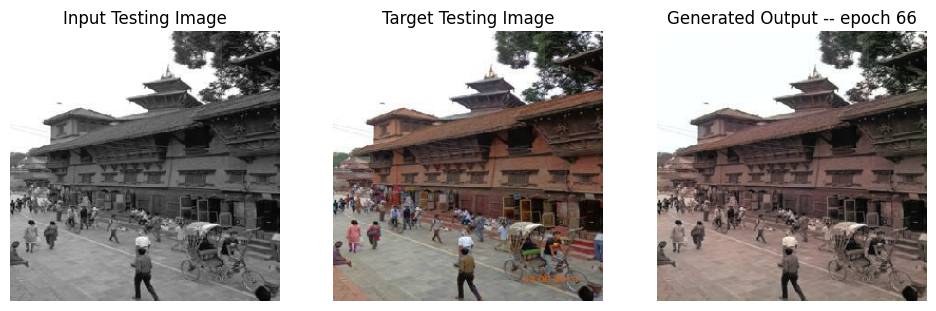

SSIM Score: 0.97782963514328
PSNR Score: 30.27621078491211
Epoch 66
Training Details
Generator-- total_loss:2.58 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:11.01 real_loss:11.01 generated_loss:0.00 --- SSIM 0.95 PSNR 25.80
Time taken for epoch 67 is 110.81227517127991 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.12 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:14.72 real_loss:14.72 generated_loss:0.00 --- SSIM 0.95 PSNR 24.65
Time taken for epoch 67 is 125.0343370437622 sec
Number of iteration 70: and Lambda = 85.69121343897604
Epoch 67
Training Details
Generator-- total_loss:2.55 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:10.91 real_loss:10.91 generated_loss:0.00 --- SSIM 0.95 PSNR 25.85
Time taken for epoch 68 is 109.92833304405212 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:2.98 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:14.24 real_loss:14.24 generated_loss:0.00 --- SSIM 0.95 PSNR 25.13
T

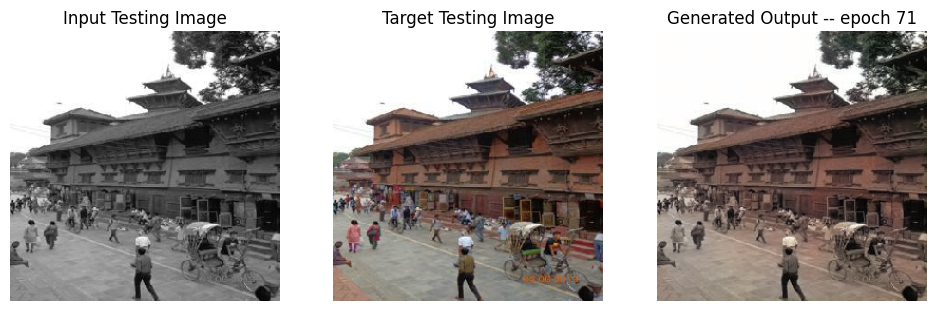

SSIM Score: 0.9798205494880676
PSNR Score: 30.888219833374023
Epoch 71
Training Details
Generator-- total_loss:11.24 gan_loss:8.52 l1_loss:0.03 Discriminator-- total_loss:0.03 real_loss:0.01 generated_loss:0.02 --- SSIM 0.96 PSNR 26.02
Time taken for epoch 72 is 119.22055864334106 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.60 gan_loss:0.37 l1_loss:0.03 Discriminator-- total_loss:2.02 real_loss:1.65 generated_loss:0.37 --- SSIM 0.95 PSNR 25.17
Time taken for epoch 72 is 133.26527857780457 sec
Number of iteration 70: and Lambda = 92.54651051409412
Epoch 72
Training Details
Generator-- total_loss:12.16 gan_loss:9.43 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.00
Time taken for epoch 73 is 119.98798680305481 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.38 gan_loss:0.15 l1_loss:0.03 Discriminator-- total_loss:2.86 real_loss:2.67 generated_loss:0.19 --- SSIM 0.95 PSNR 25.17
Tim

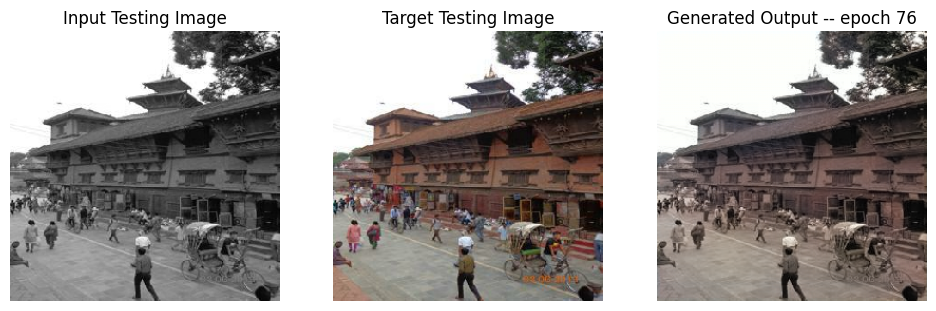

SSIM Score: 0.977388858795166
PSNR Score: 30.383676528930664
Epoch 76
Training Details
Generator-- total_loss:2.94 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:12.18 real_loss:12.18 generated_loss:0.00 --- SSIM 0.96 PSNR 26.05
Time taken for epoch 77 is 108.95495629310608 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.61 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:12.38 real_loss:12.38 generated_loss:0.00 --- SSIM 0.95 PSNR 24.94
Time taken for epoch 77 is 122.84429407119751 sec
Number of iteration 70: and Lambda = 99.95023135522166
Epoch 77
Training Details
Generator-- total_loss:2.92 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:11.57 real_loss:11.57 generated_loss:0.00 --- SSIM 0.96 PSNR 26.10
Time taken for epoch 78 is 109.39296865463257 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.56 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:12.62 real_loss:12.62 generated_loss:0.00 --- SSIM 0.95 PSNR 25.0

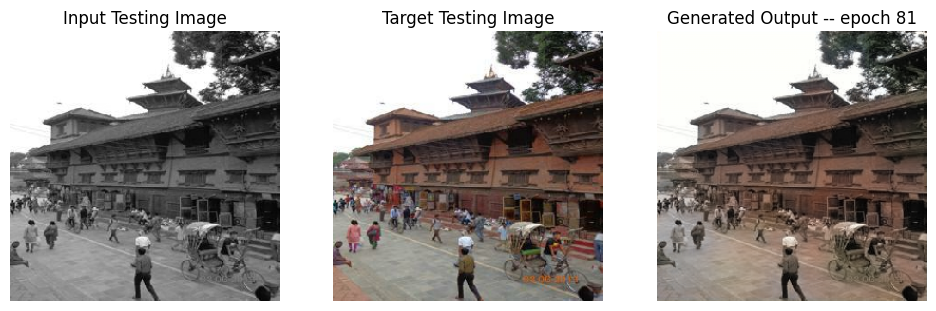

SSIM Score: 0.9791935086250305
PSNR Score: 30.28644371032715
Epoch 81
Training Details
Generator-- total_loss:2.90 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:12.33 real_loss:12.32 generated_loss:0.00 --- SSIM 0.96 PSNR 26.24
Time taken for epoch 82 is 109.5033221244812 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:3.65 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:12.47 real_loss:12.47 generated_loss:0.00 --- SSIM 0.95 PSNR 24.85
Time taken for epoch 82 is 123.34845471382141 sec
Number of iteration 70: and Lambda = 99.95023135522166
Reduced discriminator learning rate to 0.00032768002711236477 at epoch 82.
Epoch 82
Training Details
Generator-- total_loss:9.01 gan_loss:5.87 l1_loss:0.03 Discriminator-- total_loss:0.28 real_loss:0.17 generated_loss:0.12 --- SSIM 0.96 PSNR 26.19
Time taken for epoch 83 is 118.06281423568726 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.47 gan_loss:0.73 l1_loss:0.03 Discriminator-- tota

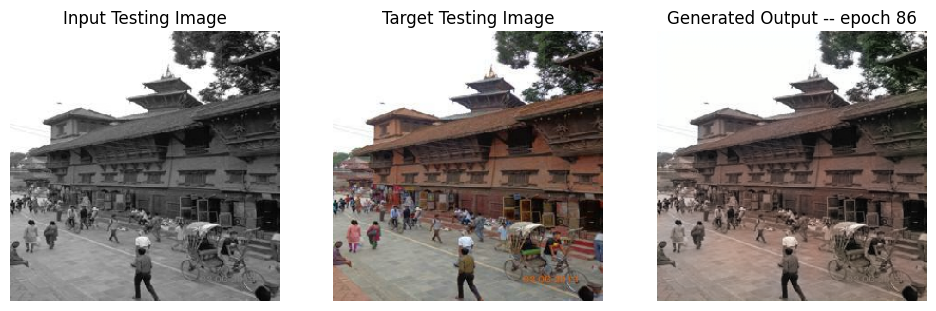

SSIM Score: 0.9786633849143982
PSNR Score: 30.241727828979492
Epoch 86
Training Details
Generator-- total_loss:13.94 gan_loss:10.80 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.19
Time taken for epoch 87 is 118.36671304702759 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.14 gan_loss:0.40 l1_loss:0.03 Discriminator-- total_loss:2.28 real_loss:1.89 generated_loss:0.39 --- SSIM 0.96 PSNR 25.27
Time taken for epoch 87 is 132.16424894332886 sec
Number of iteration 70: and Lambda = 107.9462498636394
Epoch 87
Training Details
Generator-- total_loss:14.93 gan_loss:11.79 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.19
Time taken for epoch 88 is 117.31586265563965 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.34 gan_loss:2.60 l1_loss:0.03 Discriminator-- total_loss:2.72 real_loss:0.93 generated_loss:1.79 --- SSIM 0.96 PSNR 25.26
T

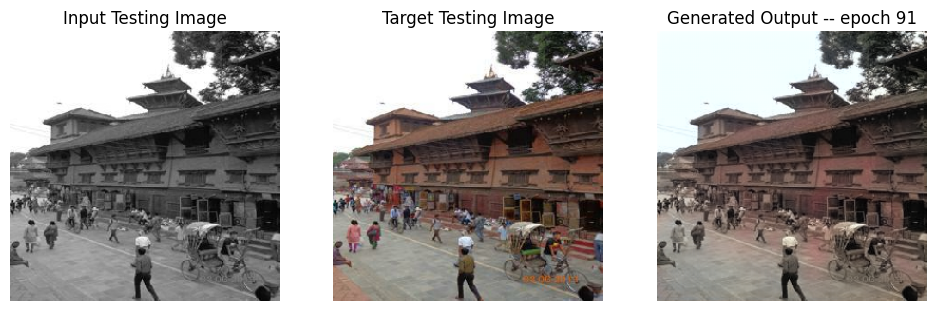

SSIM Score: 0.9784665703773499
PSNR Score: 29.989120483398438
Epoch 91
Training Details
Generator-- total_loss:3.45 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:9.25 real_loss:9.24 generated_loss:0.01 --- SSIM 0.96 PSNR 26.03
Time taken for epoch 92 is 109.00405859947205 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.49 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:8.49 real_loss:8.49 generated_loss:0.00 --- SSIM 0.95 PSNR 24.44
Time taken for epoch 92 is 122.70237159729004 sec
Number of iteration 70: and Lambda = 116.58194985273056
Epoch 92
Training Details
Generator-- total_loss:3.41 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.69 real_loss:8.68 generated_loss:0.01 --- SSIM 0.96 PSNR 26.14
Time taken for epoch 93 is 108.53092050552368 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.27 gan_loss:0.01 l1_loss:0.04 Discriminator-- total_loss:7.81 real_loss:7.81 generated_loss:0.00 --- SSIM 0.95 PSNR 24.81
Time

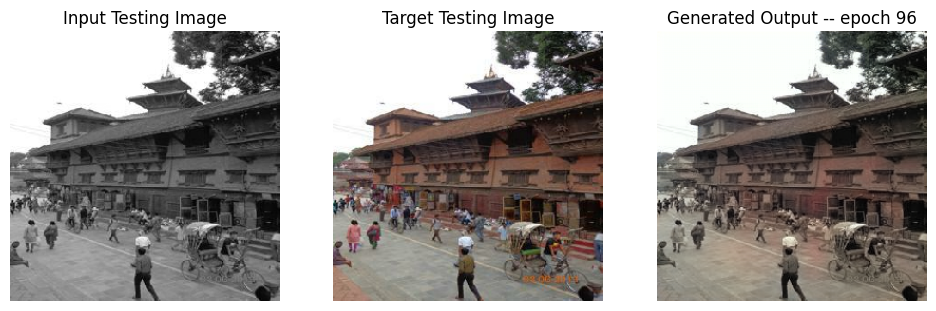

SSIM Score: 0.9778561592102051
PSNR Score: 30.359390258789062
Epoch 96
Training Details
Generator-- total_loss:12.73 gan_loss:9.07 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.13
Time taken for epoch 97 is 118.71355533599854 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.05 gan_loss:0.60 l1_loss:0.04 Discriminator-- total_loss:1.75 real_loss:1.34 generated_loss:0.41 --- SSIM 0.95 PSNR 25.08
Time taken for epoch 97 is 132.4498302936554 sec
Number of iteration 70: and Lambda = 125.90850584094902
Epoch 97
Training Details
Generator-- total_loss:13.68 gan_loss:10.02 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.12
Time taken for epoch 98 is 118.7336847782135 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.13 gan_loss:0.68 l1_loss:0.04 Discriminator-- total_loss:2.40 real_loss:1.55 generated_loss:0.85 --- SSIM 0.95 PSNR 25.08
Tim

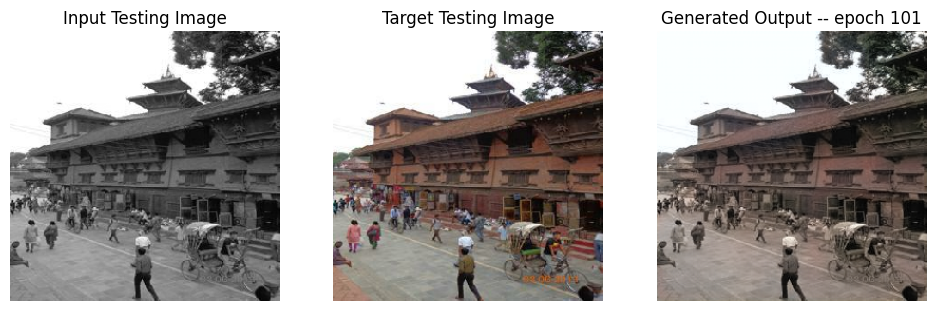

SSIM Score: 0.9787862300872803
PSNR Score: 30.733327865600586
Epoch 101
Training Details
Generator-- total_loss:3.85 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:9.73 real_loss:9.73 generated_loss:0.00 --- SSIM 0.96 PSNR 26.28
Time taken for epoch 102 is 109.80593752861023 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.95 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.52 real_loss:11.52 generated_loss:0.00 --- SSIM 0.95 PSNR 24.85
Time taken for epoch 102 is 123.80851626396179 sec
Number of iteration 70: and Lambda = 135.98118630822495
Epoch 102
Training Details
Generator-- total_loss:3.86 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:9.93 real_loss:9.93 generated_loss:0.00 --- SSIM 0.96 PSNR 26.30
Time taken for epoch 103 is 109.87701797485352 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.02 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.68 real_loss:11.68 generated_loss:0.00 --- SSIM 0.95 PSNR 2

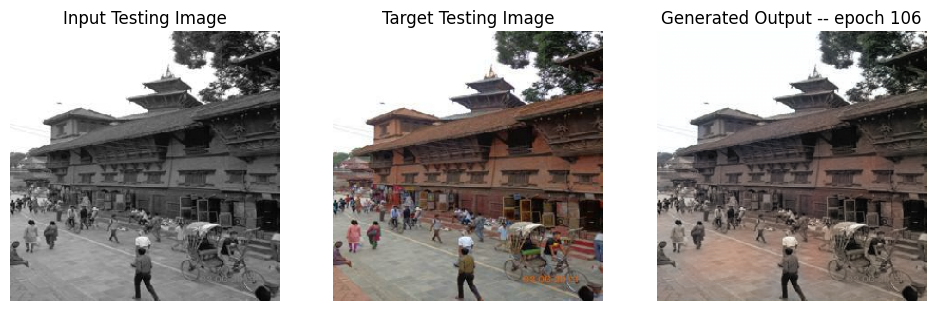

SSIM Score: 0.9764256477355957
PSNR Score: 29.152185440063477
Epoch 106
Training Details
Generator-- total_loss:3.83 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:9.81 real_loss:9.81 generated_loss:0.00 --- SSIM 0.96 PSNR 26.32
Time taken for epoch 107 is 109.49774765968323 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:4.96 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.70 real_loss:11.69 generated_loss:0.00 --- SSIM 0.96 PSNR 24.90
Time taken for epoch 107 is 123.35119819641113 sec
Number of iteration 70: and Lambda = 135.98118630822495
Reduced discriminator learning rate to 0.00020971521735191345 at epoch 107.
Epoch 107
Training Details
Generator-- total_loss:12.88 gan_loss:8.78 l1_loss:0.03 Discriminator-- total_loss:0.08 real_loss:0.05 generated_loss:0.03 --- SSIM 0.96 PSNR 26.36
Time taken for epoch 108 is 119.5150191783905 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.40 gan_loss:1.37 l1_loss:0.03 Discriminator

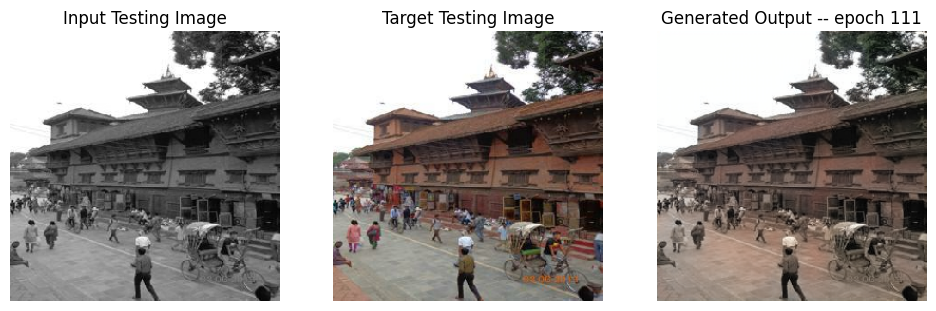

SSIM Score: 0.9790055155754089
PSNR Score: 29.910612106323242
Reduced generator learning rate to 0.00016777217388153076 at epoch 111
Epoch 111
Training Details
Generator-- total_loss:4.68 gan_loss:0.07 l1_loss:0.03 Discriminator-- total_loss:8.18 real_loss:8.18 generated_loss:0.00 --- SSIM 0.96 PSNR 26.01
Time taken for epoch 112 is 109.45101714134216 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.85 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.28 real_loss:10.27 generated_loss:0.00 --- SSIM 0.95 PSNR 24.72
Time taken for epoch 112 is 123.49147820472717 sec
Number of iteration 70: and Lambda = 158.60845570991358
Epoch 112
Training Details
Generator-- total_loss:4.53 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.04 real_loss:7.04 generated_loss:0.00 --- SSIM 0.96 PSNR 26.18
Time taken for epoch 113 is 110.241530418396 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.53 gan_loss:0.00 l1_loss:0.03 Discriminator-- tota

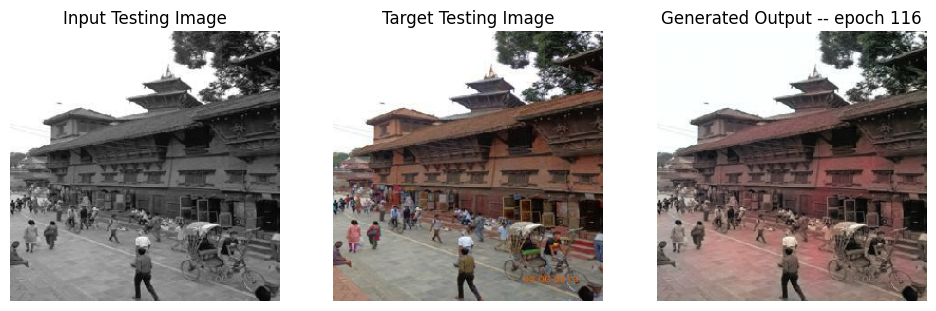

SSIM Score: 0.9761552214622498
PSNR Score: 28.530439376831055
Epoch 116
Training Details
Generator-- total_loss:4.48 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.03 real_loss:7.03 generated_loss:0.00 --- SSIM 0.96 PSNR 26.26
Time taken for epoch 117 is 109.42072916030884 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.59 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:9.61 real_loss:9.61 generated_loss:0.00 --- SSIM 0.95 PSNR 24.94
Time taken for epoch 117 is 123.39889931678772 sec
Number of iteration 70: and Lambda = 158.60845570991358
Epoch 117
Training Details
Generator-- total_loss:4.48 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.10 real_loss:7.10 generated_loss:0.00 --- SSIM 0.96 PSNR 26.25
Time taken for epoch 118 is 109.22359943389893 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:5.61 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:9.97 real_loss:9.97 generated_loss:0.00 --- SSIM 0.95 PSNR 25.09

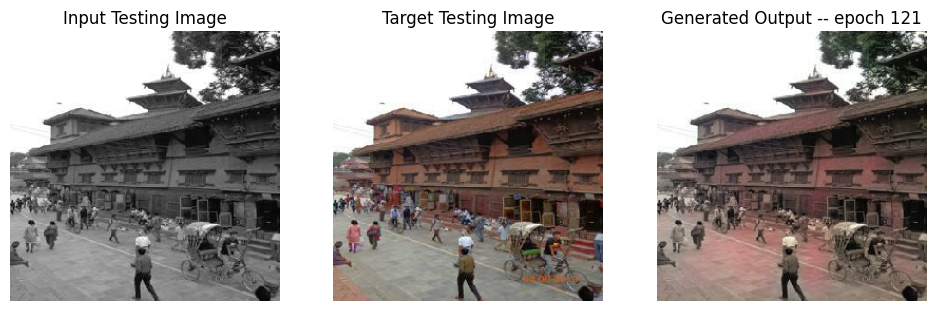

SSIM Score: 0.9766127467155457
PSNR Score: 28.815141677856445
Epoch 121
Training Details
Generator-- total_loss:15.69 gan_loss:10.91 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.30
Time taken for epoch 122 is 118.99283480644226 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.16 gan_loss:1.22 l1_loss:0.03 Discriminator-- total_loss:2.62 real_loss:1.62 generated_loss:0.99 --- SSIM 0.95 PSNR 25.20
Time taken for epoch 122 is 132.79891157150269 sec
Number of iteration 70: and Lambda = 171.2971321667067
Epoch 122
Training Details
Generator-- total_loss:15.43 gan_loss:10.64 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.29
Time taken for epoch 123 is 119.3457543849945 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:6.52 gan_loss:0.57 l1_loss:0.03 Discriminator-- total_loss:1.90 real_loss:1.39 generated_loss:0.52 --- SSIM 0.95 PSNR 25.

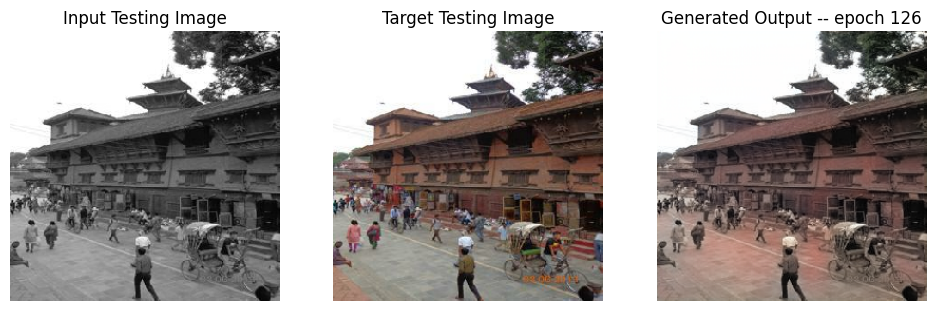

SSIM Score: 0.9770963788032532
PSNR Score: 28.91923713684082
Epoch 126
Training Details
Generator-- total_loss:5.21 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:9.44 real_loss:9.44 generated_loss:0.01 --- SSIM 0.96 PSNR 26.30
Time taken for epoch 127 is 109.73921394348145 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.52 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.60 real_loss:11.60 generated_loss:0.00 --- SSIM 0.95 PSNR 24.03
Time taken for epoch 127 is 123.56976962089539 sec
Number of iteration 70: and Lambda = 185.00090274004324
Epoch 127
Training Details
Generator-- total_loss:5.19 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:9.35 real_loss:9.34 generated_loss:0.00 --- SSIM 0.96 PSNR 26.35
Time taken for epoch 128 is 109.28550362586975 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.17 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.99 real_loss:10.99 generated_loss:0.00 --- SSIM 0.95 PSNR 24

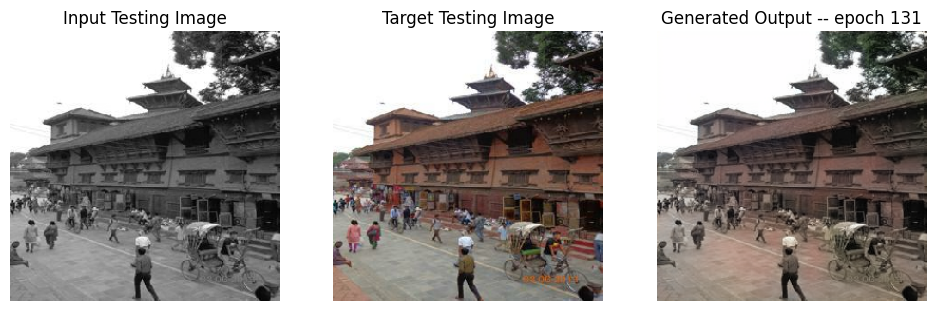

SSIM Score: 0.9786314964294434
PSNR Score: 29.880821228027344
Reduced discriminator learning rate to 0.00013421773910522462 at epoch 131.
Epoch 131
Training Details
Generator-- total_loss:12.85 gan_loss:7.37 l1_loss:0.03 Discriminator-- total_loss:0.15 real_loss:0.08 generated_loss:0.08 --- SSIM 0.96 PSNR 26.53
Time taken for epoch 132 is 118.99534964561462 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.49 gan_loss:1.60 l1_loss:0.03 Discriminator-- total_loss:1.78 real_loss:0.62 generated_loss:1.16 --- SSIM 0.96 PSNR 25.29
Time taken for epoch 132 is 132.81036615371704 sec
Number of iteration 70: and Lambda = 199.80097495924673
Epoch 132
Training Details
Generator-- total_loss:14.12 gan_loss:8.62 l1_loss:0.03 Discriminator-- total_loss:0.03 real_loss:0.01 generated_loss:0.02 --- SSIM 0.96 PSNR 26.52
Time taken for epoch 133 is 118.45778250694275 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.74 gan_loss:0.86 l1_loss:0.03 Discriminator

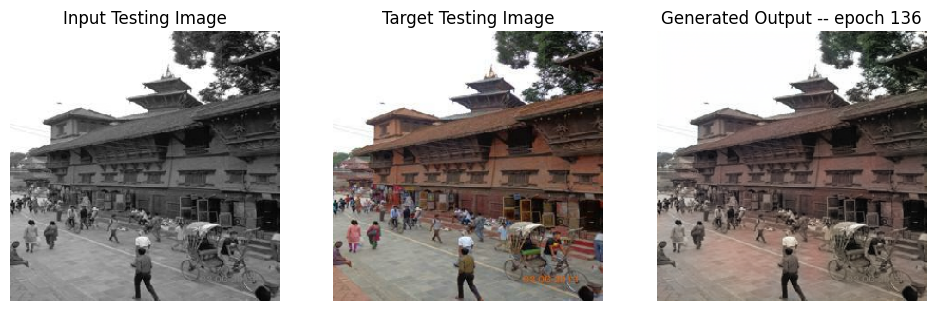

SSIM Score: 0.9782841801643372
PSNR Score: 29.883012771606445
Epoch 136
Training Details
Generator-- total_loss:16.76 gan_loss:11.26 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.52
Time taken for epoch 137 is 119.50009083747864 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.00 gan_loss:1.11 l1_loss:0.03 Discriminator-- total_loss:1.58 real_loss:0.72 generated_loss:0.86 --- SSIM 0.96 PSNR 25.28
Time taken for epoch 137 is 133.53394842147827 sec
Number of iteration 70: and Lambda = 199.80097495924673
Epoch 137
Training Details
Generator-- total_loss:16.66 gan_loss:11.19 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.55
Time taken for epoch 138 is 119.89038372039795 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.69 gan_loss:0.81 l1_loss:0.03 Discriminator-- total_loss:1.67 real_loss:1.05 generated_loss:0.62 --- SSIM 0.96 PSNR 2

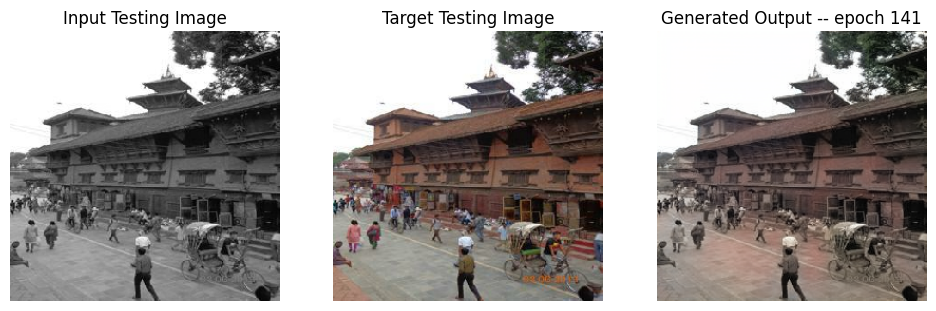

SSIM Score: 0.9783475995063782
PSNR Score: 29.91842269897461
Epoch 141
Training Details
Generator-- total_loss:18.08 gan_loss:12.59 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.53
Time taken for epoch 142 is 119.30341529846191 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.87 gan_loss:0.98 l1_loss:0.03 Discriminator-- total_loss:1.78 real_loss:1.09 generated_loss:0.69 --- SSIM 0.96 PSNR 25.29
Time taken for epoch 142 is 133.30958676338196 sec
Number of iteration 70: and Lambda = 199.80097495924673
Epoch 142
Training Details
Generator-- total_loss:18.23 gan_loss:12.76 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.54
Time taken for epoch 143 is 118.8429605960846 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.06 gan_loss:1.18 l1_loss:0.03 Discriminator-- total_loss:1.53 real_loss:0.68 generated_loss:0.85 --- SSIM 0.96 PSNR 25.

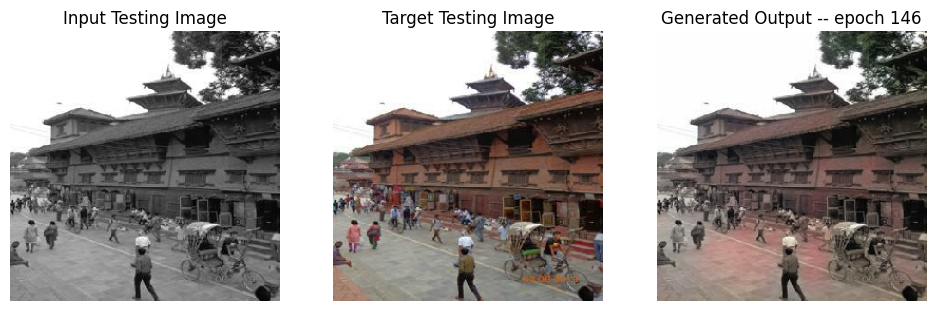

SSIM Score: 0.9766188263893127
PSNR Score: 29.078502655029297
Epoch 146
Training Details
Generator-- total_loss:5.96 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.11 real_loss:8.11 generated_loss:0.00 --- SSIM 0.96 PSNR 26.49
Time taken for epoch 147 is 109.48283004760742 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.55 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:10.82 real_loss:10.82 generated_loss:0.00 --- SSIM 0.96 PSNR 25.19
Time taken for epoch 147 is 123.34921479225159 sec
Number of iteration 70: and Lambda = 215.7850529559865
Epoch 147
Training Details
Generator-- total_loss:5.94 gan_loss:0.01 l1_loss:0.03 Discriminator-- total_loss:7.88 real_loss:7.88 generated_loss:0.00 --- SSIM 0.96 PSNR 26.54
Time taken for epoch 148 is 109.36073350906372 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:7.48 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:10.54 real_loss:10.54 generated_loss:0.00 --- SSIM 0.96 PSNR 25

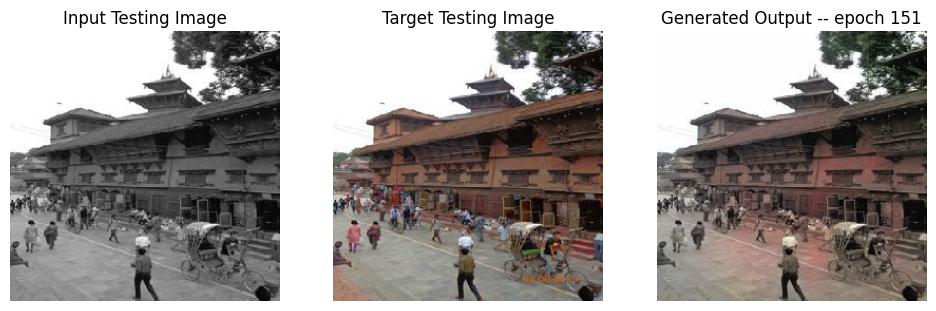

SSIM Score: 0.9777748584747314
PSNR Score: 29.630155563354492
Epoch 151
Training Details
Generator-- total_loss:15.63 gan_loss:9.26 l1_loss:0.03 Discriminator-- total_loss:0.04 real_loss:0.02 generated_loss:0.02 --- SSIM 0.96 PSNR 26.57
Time taken for epoch 152 is 118.99589085578918 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.31 gan_loss:0.23 l1_loss:0.03 Discriminator-- total_loss:2.82 real_loss:2.68 generated_loss:0.15 --- SSIM 0.96 PSNR 25.27
Time taken for epoch 152 is 133.0006856918335 sec
Number of iteration 70: and Lambda = 233.04785719246541
Epoch 152
Training Details
Generator-- total_loss:16.40 gan_loss:10.04 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.58
Time taken for epoch 153 is 119.09171295166016 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.33 gan_loss:0.25 l1_loss:0.03 Discriminator-- total_loss:2.49 real_loss:2.32 generated_loss:0.17 --- SSIM 0.96 PSNR 25.

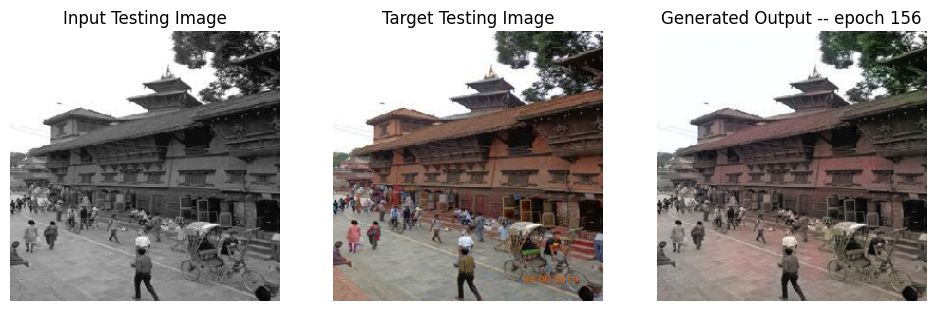

SSIM Score: 0.9771256446838379
PSNR Score: 29.863609313964844
Epoch 156
Training Details
Generator-- total_loss:7.00 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.48 real_loss:8.48 generated_loss:0.00 --- SSIM 0.96 PSNR 26.34
Time taken for epoch 157 is 109.07075333595276 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.84 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.01 real_loss:11.01 generated_loss:0.00 --- SSIM 0.96 PSNR 25.14
Time taken for epoch 157 is 122.80597305297852 sec
Number of iteration 70: and Lambda = 251.69168576786265
Epoch 157
Training Details
Generator-- total_loss:6.95 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.30 real_loss:8.30 generated_loss:0.00 --- SSIM 0.96 PSNR 26.40
Time taken for epoch 158 is 108.81992197036743 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:8.75 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:11.32 real_loss:11.32 generated_loss:0.00 --- SSIM 0.96 PSNR 2

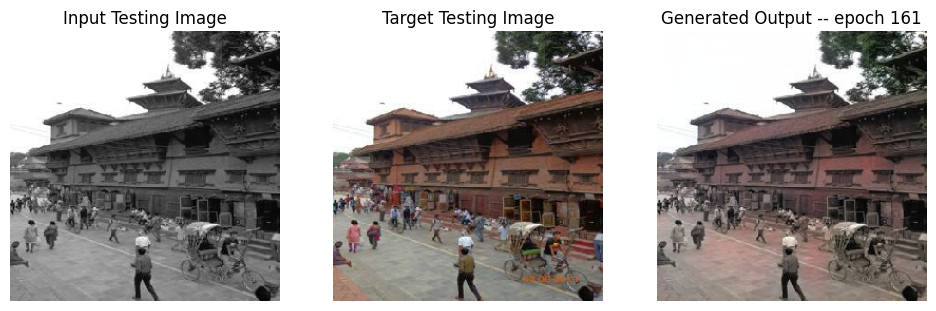

SSIM Score: 0.9768438935279846
PSNR Score: 29.74340057373047
Epoch 161
Training Details
Generator-- total_loss:6.92 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:8.69 real_loss:8.68 generated_loss:0.00 --- SSIM 0.96 PSNR 26.46
Time taken for epoch 162 is 108.96710276603699 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:9.01 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.19 real_loss:11.19 generated_loss:0.00 --- SSIM 0.95 PSNR 25.00
Time taken for epoch 162 is 122.984703540802 sec
Number of iteration 70: and Lambda = 251.69168576786265
Reduced discriminator learning rate to 8.589935605414213e-05 at epoch 162.
Epoch 162
Training Details
Generator-- total_loss:14.62 gan_loss:7.13 l1_loss:0.03 Discriminator-- total_loss:0.18 real_loss:0.10 generated_loss:0.08 --- SSIM 0.96 PSNR 26.39
Time taken for epoch 163 is 118.70772361755371 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.33 gan_loss:0.84 l1_loss:0.03 Discriminator--

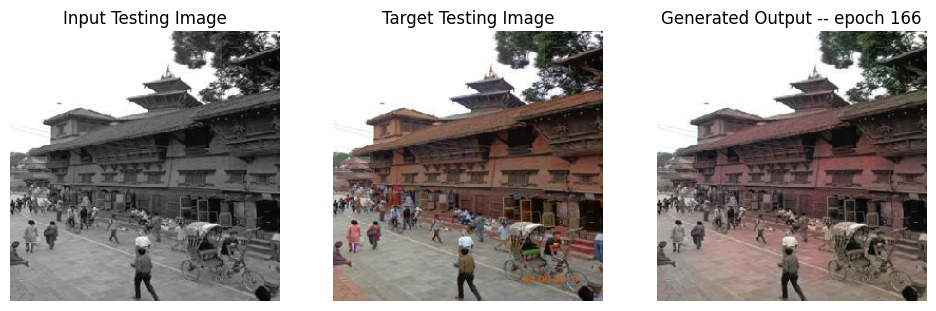

SSIM Score: 0.9777671694755554
PSNR Score: 29.907474517822266
Epoch 166
Training Details
Generator-- total_loss:16.79 gan_loss:9.27 l1_loss:0.03 Discriminator-- total_loss:0.04 real_loss:0.01 generated_loss:0.02 --- SSIM 0.96 PSNR 26.37
Time taken for epoch 167 is 118.8596339225769 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.49 gan_loss:1.03 l1_loss:0.03 Discriminator-- total_loss:1.64 real_loss:0.94 generated_loss:0.70 --- SSIM 0.96 PSNR 25.16
Time taken for epoch 167 is 132.779230594635 sec
Number of iteration 70: and Lambda = 271.82702062929167
Epoch 167
Training Details
Generator-- total_loss:17.47 gan_loss:9.97 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.39
Time taken for epoch 168 is 119.53852128982544 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.23 gan_loss:0.76 l1_loss:0.03 Discriminator-- total_loss:1.62 real_loss:1.12 generated_loss:0.51 --- SSIM 0.96 PSNR 25.1

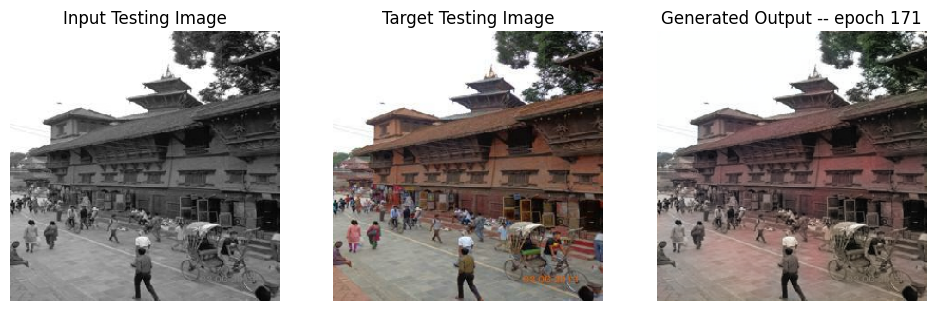

SSIM Score: 0.9777460694313049
PSNR Score: 29.88554573059082
Epoch 171
Training Details
Generator-- total_loss:18.47 gan_loss:10.95 l1_loss:0.03 Discriminator-- total_loss:0.01 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.36
Time taken for epoch 172 is 118.59661436080933 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.06 gan_loss:0.61 l1_loss:0.03 Discriminator-- total_loss:1.83 real_loss:1.46 generated_loss:0.37 --- SSIM 0.96 PSNR 25.17
Time taken for epoch 172 is 132.45524525642395 sec
Number of iteration 70: and Lambda = 271.82702062929167
Epoch 172
Training Details
Generator-- total_loss:18.93 gan_loss:11.42 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.37
Time taken for epoch 173 is 118.60799074172974 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:9.88 gan_loss:0.41 l1_loss:0.03 Discriminator-- total_loss:2.29 real_loss:2.01 generated_loss:0.27 --- SSIM 0.96 PSNR 2

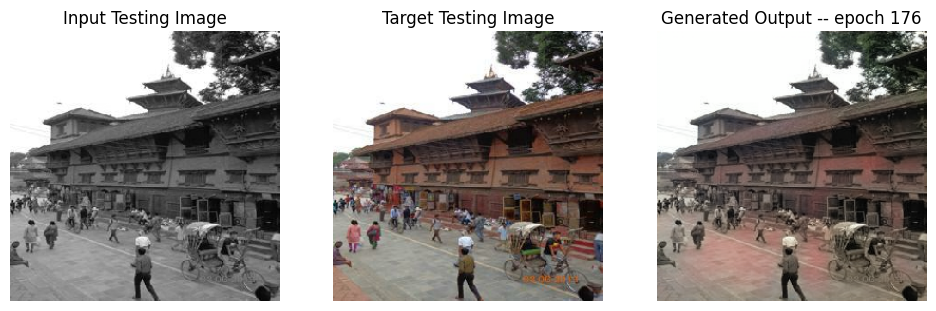

SSIM Score: 0.9768348336219788
PSNR Score: 28.99899673461914
Epoch 176
Training Details
Generator-- total_loss:8.00 gan_loss:0.03 l1_loss:0.03 Discriminator-- total_loss:8.13 real_loss:8.13 generated_loss:0.00 --- SSIM 0.96 PSNR 26.60
Time taken for epoch 177 is 109.02706050872803 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.31 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:10.89 real_loss:10.89 generated_loss:0.00 --- SSIM 0.95 PSNR 25.17
Time taken for epoch 177 is 122.94004201889038 sec
Number of iteration 70: and Lambda = 293.57318227963503
Epoch 177
Training Details
Generator-- total_loss:7.99 gan_loss:0.02 l1_loss:0.03 Discriminator-- total_loss:7.91 real_loss:7.91 generated_loss:0.00 --- SSIM 0.96 PSNR 26.61
Time taken for epoch 178 is 109.33323121070862 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:10.19 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:11.10 real_loss:11.10 generated_loss:0.00 --- SSIM 0.95 PSNR 

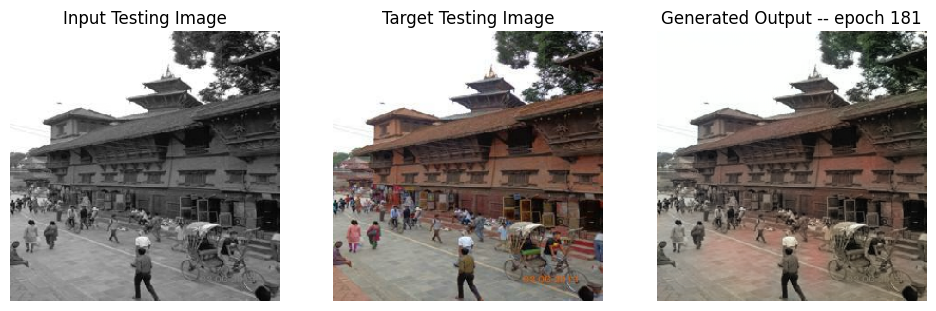

SSIM Score: 0.9785434603691101
PSNR Score: 29.760852813720703
Epoch 181
Training Details
Generator-- total_loss:19.03 gan_loss:10.44 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.59
Time taken for epoch 182 is 119.39676785469055 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.36 gan_loss:0.43 l1_loss:0.03 Discriminator-- total_loss:1.85 real_loss:1.56 generated_loss:0.30 --- SSIM 0.95 PSNR 25.26
Time taken for epoch 182 is 133.4800727367401 sec
Number of iteration 70: and Lambda = 317.0590368620059
Epoch 182
Training Details
Generator-- total_loss:19.26 gan_loss:10.69 l1_loss:0.03 Discriminator-- total_loss:0.00 real_loss:0.00 generated_loss:0.00 --- SSIM 0.96 PSNR 26.61
Time taken for epoch 183 is 119.32306933403015 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.41 gan_loss:0.49 l1_loss:0.03 Discriminator-- total_loss:1.96 real_loss:1.60 generated_loss:0.36 --- SSIM 0.95 PSNR 2

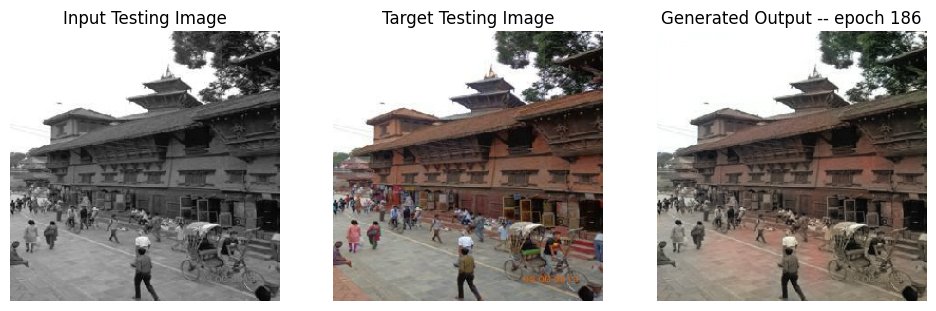

SSIM Score: 0.9785642623901367
PSNR Score: 29.807395935058594
Reduced generator learning rate to 5.497558740898967e-05 at epoch 186
Epoch 186
Training Details
Generator-- total_loss:9.54 gan_loss:0.09 l1_loss:0.03 Discriminator-- total_loss:7.58 real_loss:7.58 generated_loss:0.00 --- SSIM 0.96 PSNR 26.39
Time taken for epoch 187 is 109.94238305091858 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:12.18 gan_loss:0.00 l1_loss:0.04 Discriminator-- total_loss:11.76 real_loss:11.76 generated_loss:0.00 --- SSIM 0.95 PSNR 24.96
Time taken for epoch 187 is 123.85224628448486 sec
Number of iteration 70: and Lambda = 342.4237598109664
Epoch 187
Training Details
Generator-- total_loss:9.38 gan_loss:0.03 l1_loss:0.03 Discriminator-- total_loss:7.87 real_loss:7.87 generated_loss:0.00 --- SSIM 0.96 PSNR 26.47
Time taken for epoch 188 is 109.79421949386597 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.93 gan_loss:0.00 l1_loss:0.03 Discriminator-- to

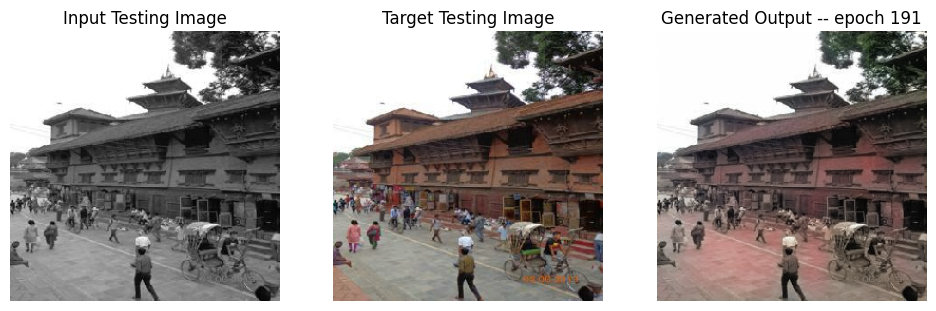

SSIM Score: 0.9752747416496277
PSNR Score: 28.34026527404785
Epoch 191
Training Details
Generator-- total_loss:9.35 gan_loss:0.03 l1_loss:0.03 Discriminator-- total_loss:8.41 real_loss:8.40 generated_loss:0.00 --- SSIM 0.96 PSNR 26.54
Time taken for epoch 192 is 108.6329619884491 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.84 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:12.39 real_loss:12.39 generated_loss:0.00 --- SSIM 0.96 PSNR 25.23
Time taken for epoch 192 is 122.33389377593994 sec
Number of iteration 70: and Lambda = 342.4237598109664
Epoch 192
Training Details
Generator-- total_loss:9.28 gan_loss:0.03 l1_loss:0.03 Discriminator-- total_loss:8.08 real_loss:8.08 generated_loss:0.00 --- SSIM 0.96 PSNR 26.58
Time taken for epoch 193 is 109.11241126060486 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:11.94 gan_loss:0.00 l1_loss:0.03 Discriminator-- total_loss:12.45 real_loss:12.45 generated_loss:0.00 --- SSIM 0.95 PSNR 25

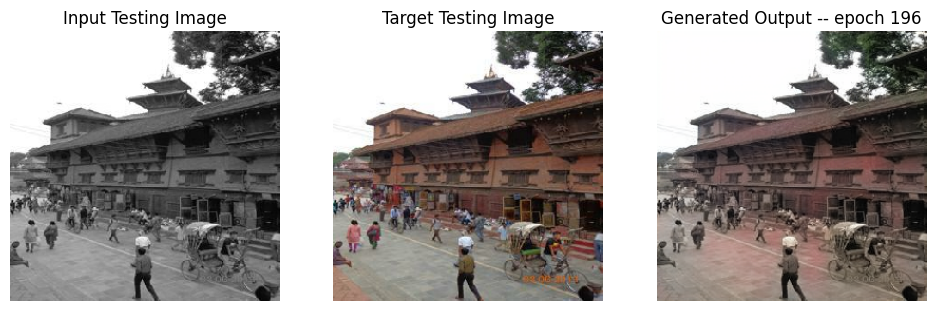

SSIM Score: 0.9779212474822998
PSNR Score: 29.798627853393555
Epoch 196
Training Details
Generator-- total_loss:19.09 gan_loss:9.09 l1_loss:0.03 Discriminator-- total_loss:0.02 real_loss:0.01 generated_loss:0.01 --- SSIM 0.96 PSNR 26.58
Time taken for epoch 197 is 117.05862545967102 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:14.31 gan_loss:1.61 l1_loss:0.03 Discriminator-- total_loss:1.78 real_loss:0.72 generated_loss:1.06 --- SSIM 0.96 PSNR 25.27
Time taken for epoch 197 is 130.67654037475586 sec
Number of iteration 70: and Lambda = 369.81766059584373
Epoch 197
Training Details
Generator-- total_loss:19.43 gan_loss:9.42 l1_loss:0.03 Discriminator-- total_loss:0.04 real_loss:0.01 generated_loss:0.03 --- SSIM 0.96 PSNR 26.58
Time taken for epoch 198 is 117.56513524055481 sec
Number of iteration {d} 245
Testing Details
Generator-- total_loss:13.50 gan_loss:0.80 l1_loss:0.03 Discriminator-- total_loss:1.47 real_loss:0.92 generated_loss:0.54 --- SSIM 0.96 PSNR 2

In [41]:
fit(train_dataset, epochs, test_dataset, gen)

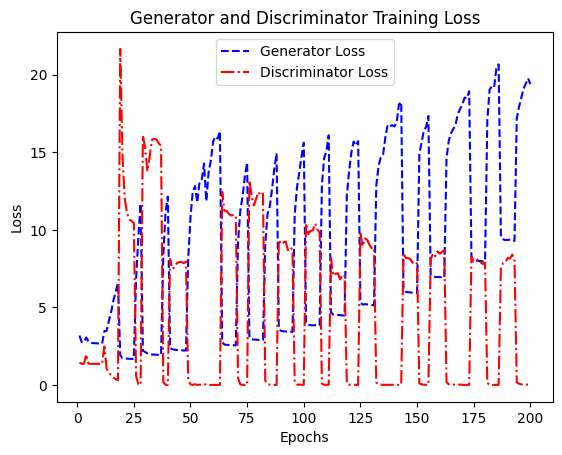

In [42]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Generator Loss')
plt.plot(epochs, train_discriminator_losses, '-.r', label='Discriminator Loss')
plt.title('Generator and Discriminator Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/train_loss_plot_1.png')
plt.show()

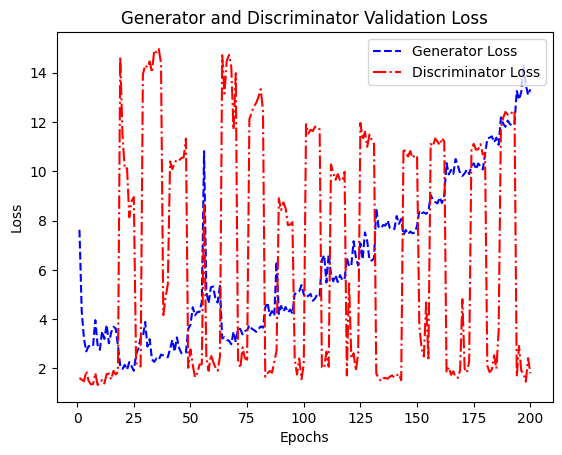

In [43]:
epochs = range(1, len(test_generator_losses) + 1)

plt.plot(epochs, test_generator_losses, '--b', label='Generator Loss')
plt.plot(epochs, test_discriminator_losses, '-.r', label='Discriminator Loss')
plt.title('Generator and Discriminator Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/test_loss_plot_1.png')
plt.show()

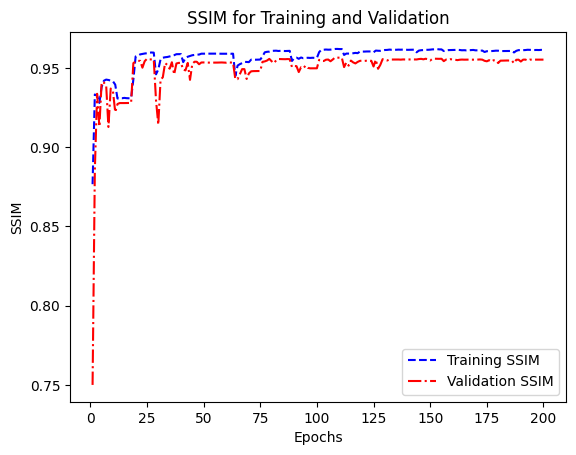

In [44]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_ssim, '--b', label='Training SSIM')
plt.plot(epochs, testing_ssim, '-.r', label='Validation SSIM')
plt.title('SSIM for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('SSIM')
plt.legend()
plt.savefig('/kaggle/working/SSIM_plot_1.png')
plt.show()

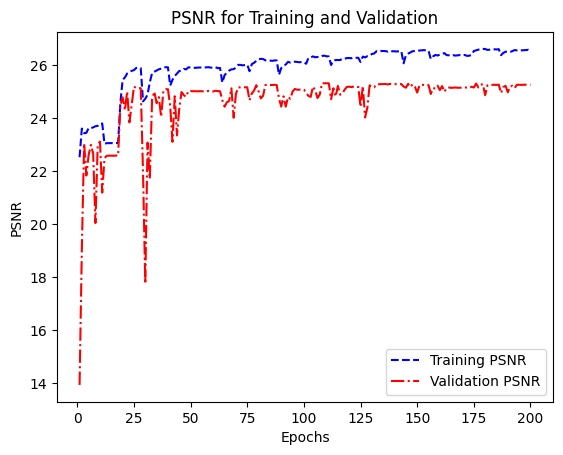

In [45]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, training_psnr, '--b', label='Training PSNR')
plt.plot(epochs, testing_psnr, '-.r', label='Validation PSNR')
plt.title('PSNR for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('PSNR')
plt.legend()
plt.savefig('/kaggle/working/PSNR_plot_1.png')
plt.show()

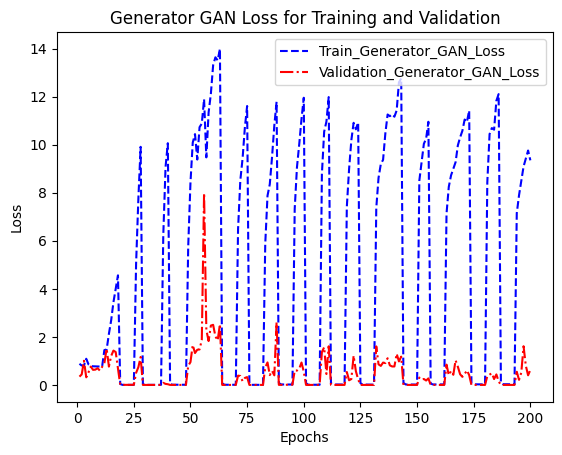

In [46]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_gan_losses, '--b', label='Train_Generator_GAN_Loss')
plt.plot(epochs, test_generator_gan_losses, '-.r', label='Validation_Generator_GAN_Loss')
plt.title('Generator GAN Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_GAN_plot_1.png')
plt.show()

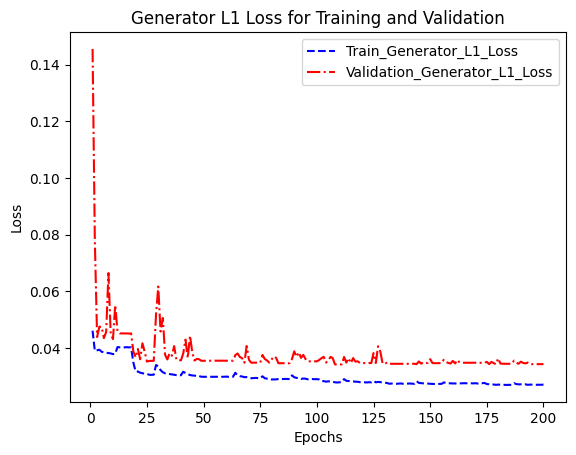

In [47]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_l1_losses, '--b', label='Train_Generator_L1_Loss')
plt.plot(epochs, test_generator_l1_losses, '-.r', label='Validation_Generator_L1_Loss')
plt.title('Generator L1 Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_L1_plot_1.png')
plt.show()

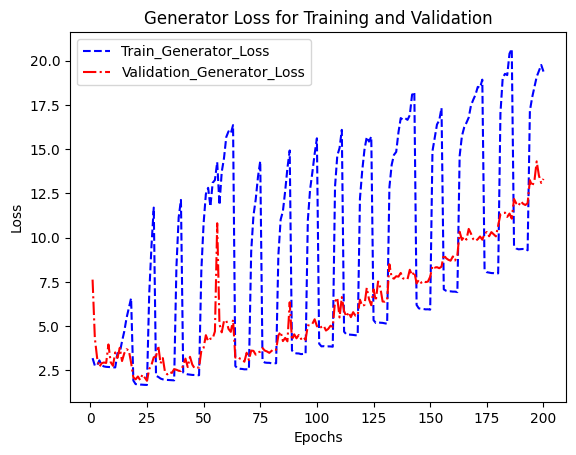

In [48]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_generator_losses, '--b', label='Train_Generator_Loss')
plt.plot(epochs, test_generator_losses, '-.r', label='Validation_Generator_Loss')
plt.title('Generator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Gen_plot_1.png')
plt.show()

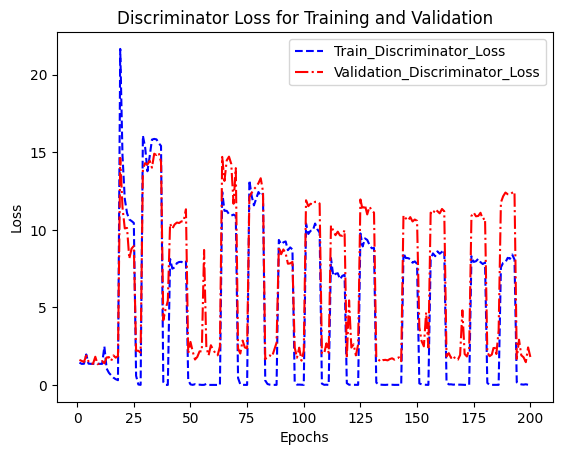

In [49]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_losses, '--b', label='Train_Discriminator_Loss')
plt.plot(epochs, test_discriminator_losses, '-.r', label='Validation_Discriminator_Loss')
plt.title('Discriminator Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_plot_1.png')
plt.show()

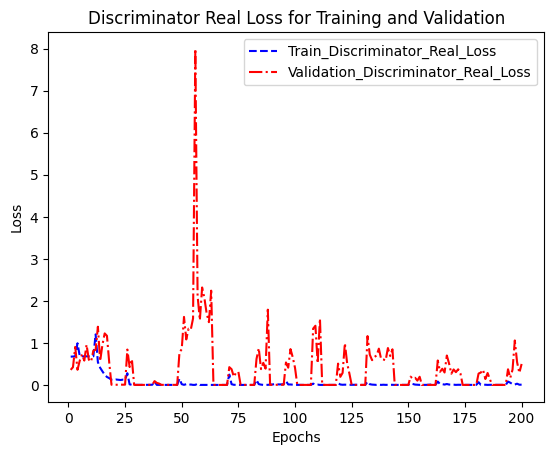

In [50]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_real_losses, '--b', label='Train_Discriminator_Real_Loss')
plt.plot(epochs, test_discriminator_real_losses, '-.r', label='Validation_Discriminator_Real_Loss')
plt.title('Discriminator Real Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Real_plot_1.png')
plt.show()

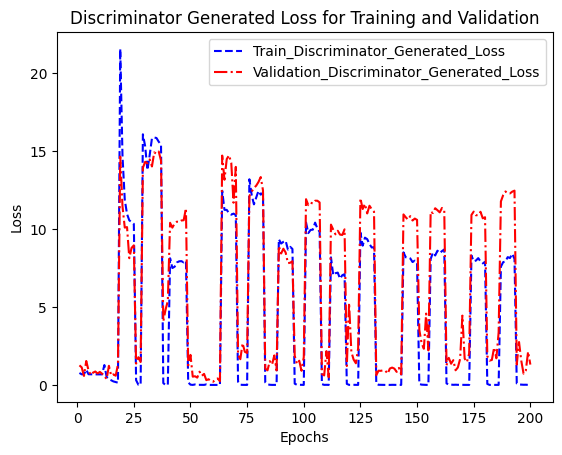

In [51]:
epochs = range(1, len(train_generator_losses) + 1)

plt.plot(epochs, train_discriminator_generated_losses, '--b', label='Train_Discriminator_Generated_Loss')
plt.plot(epochs, test_discriminator_generated_losses, '-.r', label='Validation_Discriminator_Generated_Loss')
plt.title('Discriminator Generated Loss for Training and Validation')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.savefig('/kaggle/working/Disc_Generated_plot_1.png')
plt.show()

In [52]:
import csv
with open('/kaggle/working/dataJan20.csv','w', newline='') as file:
    writer = csv.writer(file)
    writer.writerows(all_records)

In [53]:
os.mkdir('/kaggle/working/modelsJan20')

In [54]:
gen.save('/kaggle/working/modelsJan20/gen.h5')
gen.save_weights('/kaggle/working/modelsJan20/gen.keras')
disc.save('/kaggle/working/modelsJan20/disc.h5')
disc.save_weights('/kaggle/working/modelsJan20/disc.keras')

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [55]:
def download_file(path, download_file_name):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    command = f"zip {zip_name} {path} -r"
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    if result.returncode !=0:
        print("Unable to run zip command")
        print(result.stderr)
        return
    display(FileLink(f'{download_file_name}.zip'))

In [56]:
import subprocess
from IPython.display import FileLink, display

In [57]:
download_file('/kaggle/working', 'outputJan20')

/kaggle/working/outputJan20.zip